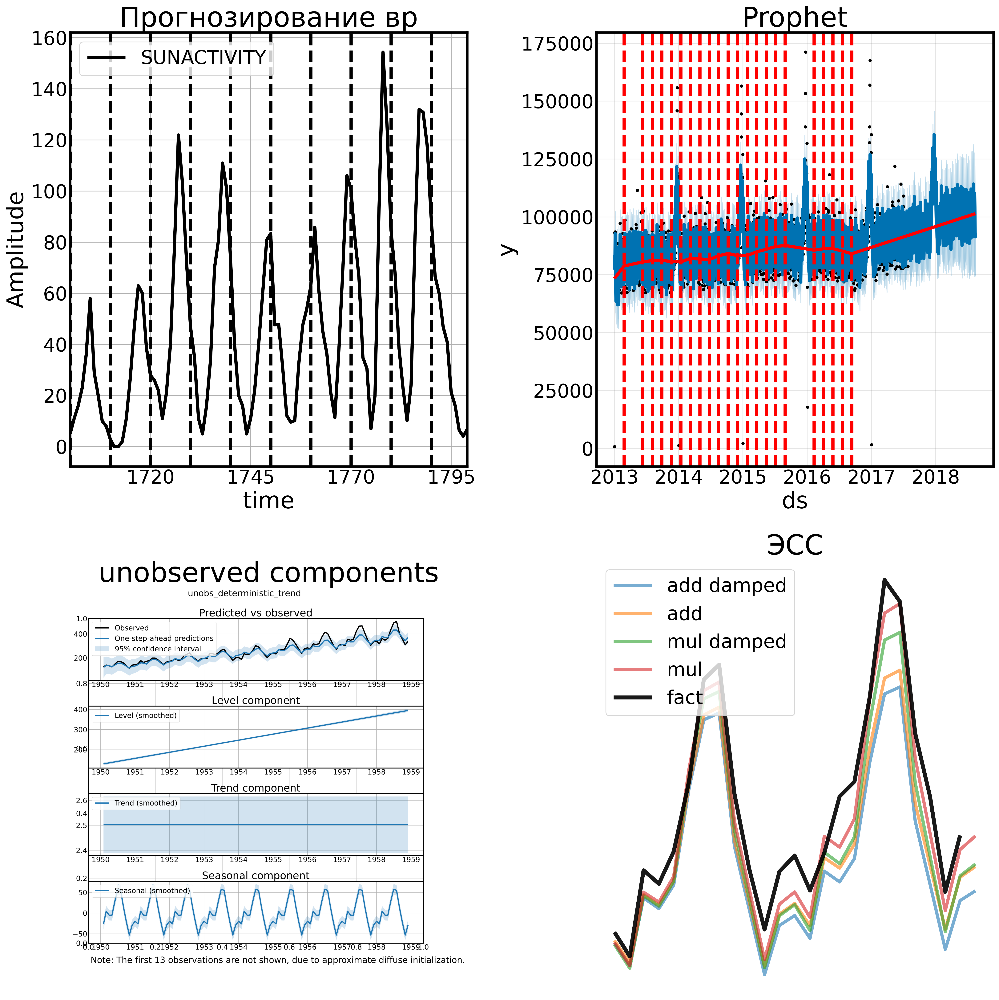

# Основные модели прогнозирования ВР <a class="tocSkip">

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import statsmodels.api as sm
from scipy import stats
from statsmodels.graphics import tsaplots
from sktime.utils.plotting import plot_correlations
from itertools import product

In [2]:
import warnings
warnings.simplefilter("ignore")

In [3]:
params = {'lines.linewidth': 4,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'large',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 3.0,
          'axes.titlesize': 'x-large',
          'grid.linestyle': '-',
          'grid.linewidth': 1.0,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (10.8, 7.8),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 24.0 }
plt.rcParams.update(params)

In [4]:
pd.options.display.max_rows = 999
%cd ..
%env PYTHONPATH=.

/home/dssaburi/projects/teta
env: PYTHONPATH=.


In [5]:
np.random.seed(555)

In [6]:
from sktime.forecasting.arima import ARIMA
from sktime.forecasting.model_selection import ExpandingWindowSplitter
from sktime.forecasting.model_evaluation import evaluate
from sktime.forecasting.arima import AutoARIMA
from scipy.stats import ttest_1samp, shapiro
from statsmodels. tsa.stattools import adfuller, kpss
from statsmodels.graphics.gofplots import qqplot
from statsmodels.stats.diagnostic import acorr_ljungbox, het_breuschpagan

In [7]:
def calc_optimum_arma(ts,
                      max_p,
                       max_q): 
    """
    Подбор оптимальных гиперпараметров модели ARMA с помощью критерия Акаике.
    Идет перебор всех вариантов (p,q) в пределах (0,max_p)*(0,max_q)
    
    """
    
    best_bic = float("inf")
    
    ps = range(0, max_p+1)
    qs = range(0, max_q+1)
    parameters = product(ps, qs)
    parameters_list = list(parameters)
    
    print(len(parameters_list))
    
    results = []
    for param in parameters_list:
        #try except нужен, потому что на некоторых наборах параметров модель не обучается
        try:
            model=ARIMA(order=(param[0], 0, param[1])).fit(ts)
        #выводим параметры, на которых модель не обучается и переходим к следующему набору
        except ValueError:
            print('wrong parameters:', param)
            continue
        aic = model._forecaster.aic()
        bic = model._forecaster.bic()
        #сохраняем лучшую модель, aic, параметры
        if bic < best_bic:
            best_model = model
            best_bic = aic
            best_param = param
        results.append([param, aic, bic]) 
    
    return results, best_model
    

In [8]:
def check_fit(resids):
    
    """
    Проверка остатков на равенство нулю среднего, на стационарность, нормальность, отсутствие автокорреляций и 
    гомоскедастичность.
    """
    
    #mean = 0
    mean_t, mean_pval = ttest_1samp(resids,0)

    # stationary
    stat_t, stat_pval = adfuller(resids,maxlag=6)[:2]

    # normality 
    norm_t, norm_pval = shapiro(resids)
    
    # autocorr 
    autocor_pval = (acorr_ljungbox(resids,model_df=0,return_df=False)['lb_pvalue'] <0.05).sum()==0
    
    # heteroscedasticity  
    lm, lm_pval, ff, ff_pval = \
    het_breuschpagan(resids,sm.add_constant(resids.reset_index().index))

    records = {
        "mean_resids" : np.mean(resids),
        "mean_t" : mean_t,
        "mean_pval" : mean_pval,
        "stationary_t" : stat_t,
        "stationary_pval": 1 - stat_pval, # поменяли знак, чтобы желаемый результат всех проверок p_value>0.05 
        'autocor_pval': autocor_pval,
        "norm_t" : norm_t,
        "norm_pval" : norm_pval,
        "heteroscedasticity_t" : ff,
        "heteroscedasticity_pval" : ff_pval,
        "check_result" : (mean_pval>0.05) & (stat_pval<0.05) & (norm_pval>0.05) &\
        (ff_pval>0.05) & autocor_pval
       }
    
    return records

In [9]:
def plot_diagnostics(data, dt_col,resid_col):
    """
    Строим визуальную оценку остатков - остатки as-is, гистограмма остатков, qqplot и автокореляционную функцию.
    """
    
    fig,ax = plt.subplots(2,2,figsize=(15,10))

    # resid as-is
    sns.lineplot(data=data, x=dt_col, y=resid_col, ax=ax[0][0]);
    ax[0][0].axhline(0, c="k", linestyle="--")
    ax[0][0].set_title("Динамика ошибок прогноза")
    ax[0][0].set_xlabel(None)
    ax[0][0].set_ylabel(None)
    ax[0][0].xaxis.set_major_locator(plt.MaxNLocator(4))

    #hist
    sns.histplot(data=data,x=resid_col,ax=ax[0][1]);
    ax[0][1].set_title("Гистограмма ошибок прогноза")
    ax[0][1].set_xlabel(None)
    ax[0][1].set_ylabel(None)

    #acf
    sm.graphics.tsa.plot_acf(data[resid_col], lags=10,ax=ax[1][0]);
    ax[1][0].set_title("Автокореляции ошибок прогноза")
    ax[1][0].set_xlabel(None)
    ax[1][0].set_ylabel(None)

    #qq
    qqplot(data[resid_col],line='s',ax=ax[1][1]);
    ax[1][1].set_title("Q-q график ошибок прогноза")
    ax[1][1].set_xlabel(None)
    ax[1][1].set_ylabel(None)

In [10]:
from sktime.performance_metrics.forecasting import MeanAbsoluteError,MeanAbsolutePercentageError
from sklearn.metrics import r2_score

def metrics_report(y_true,
                   y_pred
                  ):
    
    """
    Функция оценки качества прогноза. Оценивает персентили распределения ошибки 
    (медиану, среднее, 3й квартиль и 95-персентиль) 
    по абсолютной и относительной процентной ошибки для прогноза с помощью модели (y_pred) и
    для базового прогноза, равному среднему значению вр.
    
    """
    
    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    
    y_true_mean = y_true.mean()*np.ones(shape=(len(y_true),))
    
    
    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    
    
    mapes_zero = mape_func.evaluate_by_index(y_true,y_true_mean)*100
    maes_zero = mae_func.evaluate_by_index(y_true,y_true_mean)
    
    def quan_75(y,quan=0.75):
        return y.quantile(quan)

    def quan_95(y,quan=0.95):
        return y.quantile(quan)
    
    stats_list = ['mean','median',quan_75,quan_95,'std']
    
    res = pd.DataFrame([maes.agg(stats_list),
                        maes_zero.agg(stats_list),
                        mapes.agg(stats_list),
                        mapes_zero.agg(stats_list)],
                       index=['maes','maes_zero','mapes','mapes_zero'])
    
    res.loc["r2",:] = r2_score(y_true, y_pred)
    
    return res

In [11]:
from sktime.transformations.series.boxcox import BoxCoxTransformer
def BC_inverse(y, lam, sig):
    """Back transform Box-Cox with Bias correction.
    See https://robjhyndman.com/hyndsight/backtransforming
    """
    if lam == 0:
        return np.exp(y) * (1 + 0.5 * sig**2)
    else:
        res = np.power(lam*y + 1., 1/lam)
        res *= (1 + 0.5 * sig**2 * (1 - lam) / (lam*y + 1.)**2)
        return res

# Разбор основных моделей вр

## SARIMA

SARIMA(p,q,d,P,Q,D)  – ARMA с обычным и сезонным дифференцированием, в который добавлено P сезонных лагов и Q сезонных скользящих средних. Параметры модели:
 * d - порядок обычного дифференцирования
 * D - порядок сезонного дифференцирования
 * p - кол-во обычных авторегрессионных компонент
 * P - кол-во сезонных авторегрессионных компонент
 * q - кол-во обычных шумовых компонент
 * Q - кол-во сезонных шумовых компонент

Методология ARIMA (Бокса — Дженкинса):

    1. Графический анализ ряда
    2. Стабилизация дисперсии при необходимости
    3. Подобр порядок дифференцирования, при котором ряд становится стационарным. Таким образом фиксируются параметры d; D модели ARIMA.
    4. Построить графики автокорреляционной функции (ACF) и частичной автокорреляционной функции (PACF) и из этих графиков определить примерные значения параметров p; q; P; Q.
    5. Полученные модели необходимо обучить, сравнить их по информационному критерию Акаике и выбрать ту, которая его минимизирует.
    6. Оценка остатков

In [12]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
def test_trend(row):
    """Case 1: Both tests conclude that the series is not stationary - The series is not stationary
        Case 2: Both tests conclude that the series is stationary - The series is stationary
        Case 3: KPSS indicates stationarity and ADF indicates non-stationarity - The series is trend stationary. Trend needs to be removed to make series strict stationary. The detrended series is checked for stationarity.
        Case 4: KPSS indicates non-stationarity and ADF indicates stationarity - The series is difference stationary. Differencing is to be used to make series stationary. The differenced series is checked for stationarity.
        """
    kpsstest = kpss(row, regression="c", nlags="auto")
    dftest = adfuller(row, autolag="AIC")
    nonstationary_kpss =  kpsstest[1]<0.05
    nonstationary_df = dftest[1]>0.05
    return nonstationary_kpss | nonstationary_df,  kpsstest[1], dftest[1]

In [13]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

In [14]:
# отложим последние 24 наблюдения в тест
airline_test = airline.iloc[-24:]
airline = airline.iloc[:-24]

Шаг 1. Графический анализ ряда

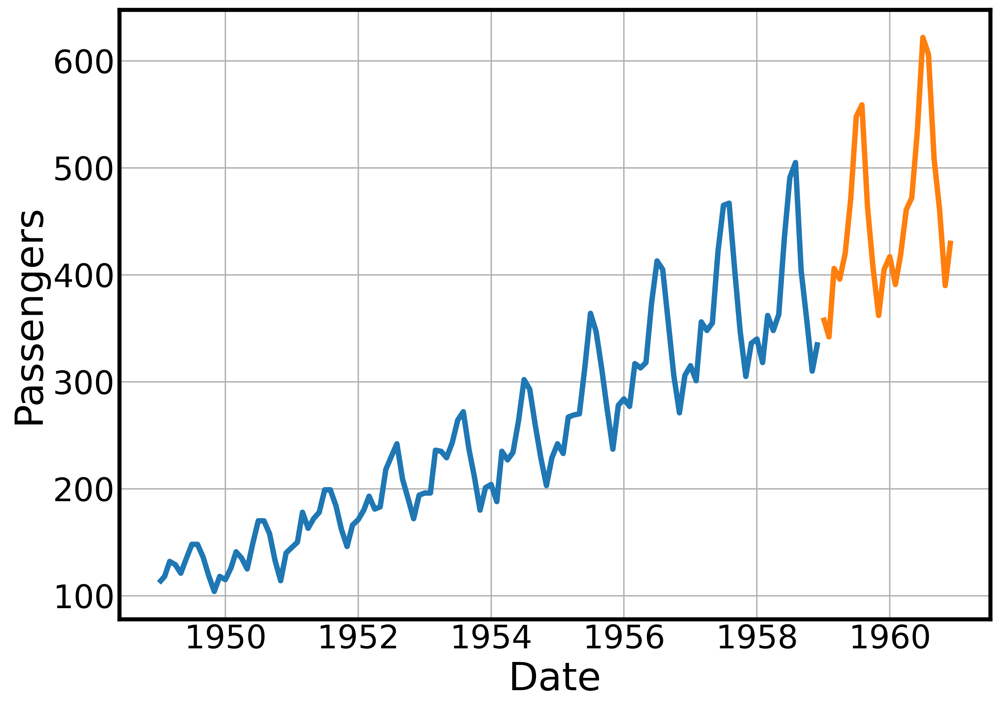

In [15]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['Passengers'])
ax.plot(airline_test.index, airline_test['Passengers'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');

имеется сезонность, мультипликативный тренд и как следствие - дисперсия растет со временем

Шаг 2. Стабилизация дисперсии

In [16]:
transformer = BoxCoxTransformer(method = "mle",sp=12)

In [17]:
airline['pass_box'] = transformer.fit_transform(airline['Passengers'])

Шаг 3. Подобр порядок дифференцирования, при котором ряд становится стационарным

(True, 0.01, 0.37863511657031124)


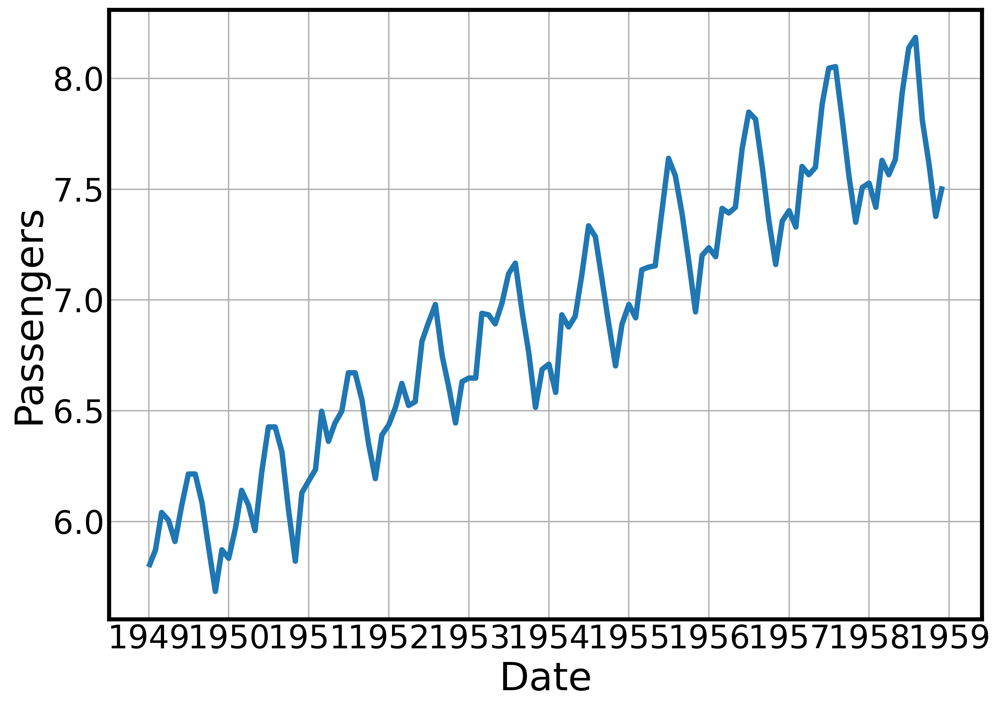

In [18]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['pass_box'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');
print(test_trend(airline['pass_box']));

In [19]:
# проверяем, что в ряду есть тренд
test_trend(airline['pass_box'])

(True, 0.01, 0.37863511657031124)

In [20]:
# начнем с сезонного дифференцирования
airline['pass_box_diff12'] = airline.pass_box - airline.pass_box.shift(12)

(True, 0.1, 0.39770143196834246)


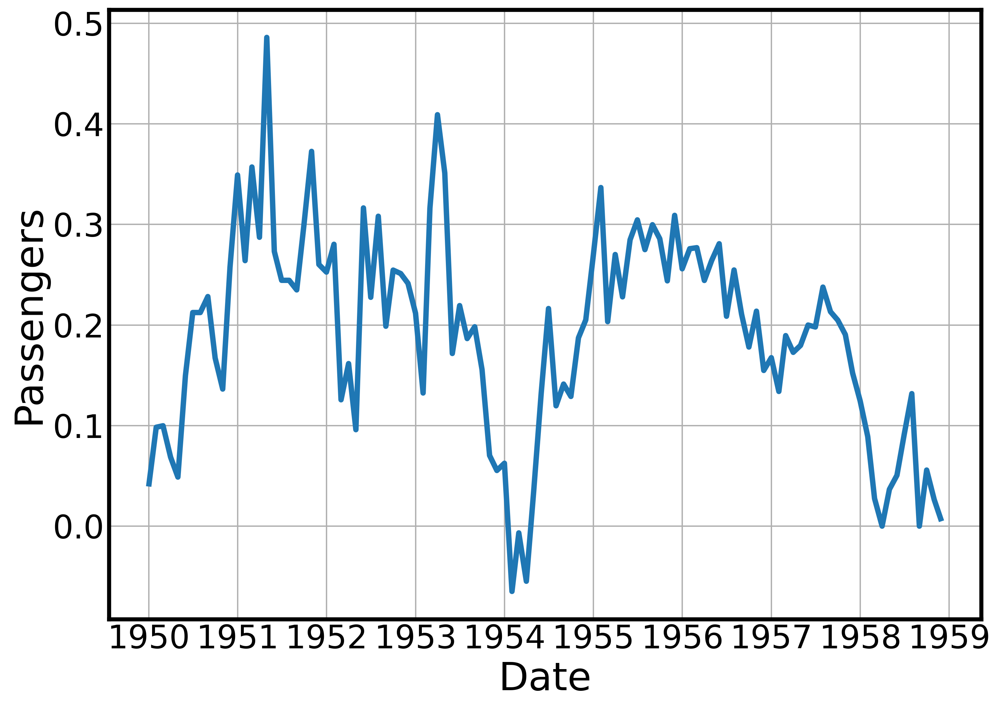

In [21]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['pass_box_diff12'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');
print(test_trend(airline['pass_box_diff12'].dropna())); # ряд по-прежнему нестационарный

In [22]:
# добавим обычное дифференцирования
airline['pass_box_diff1'] = airline.pass_box_diff12 - airline.pass_box_diff12.shift(1)

(False, 0.1, 0.0014315610362536507)


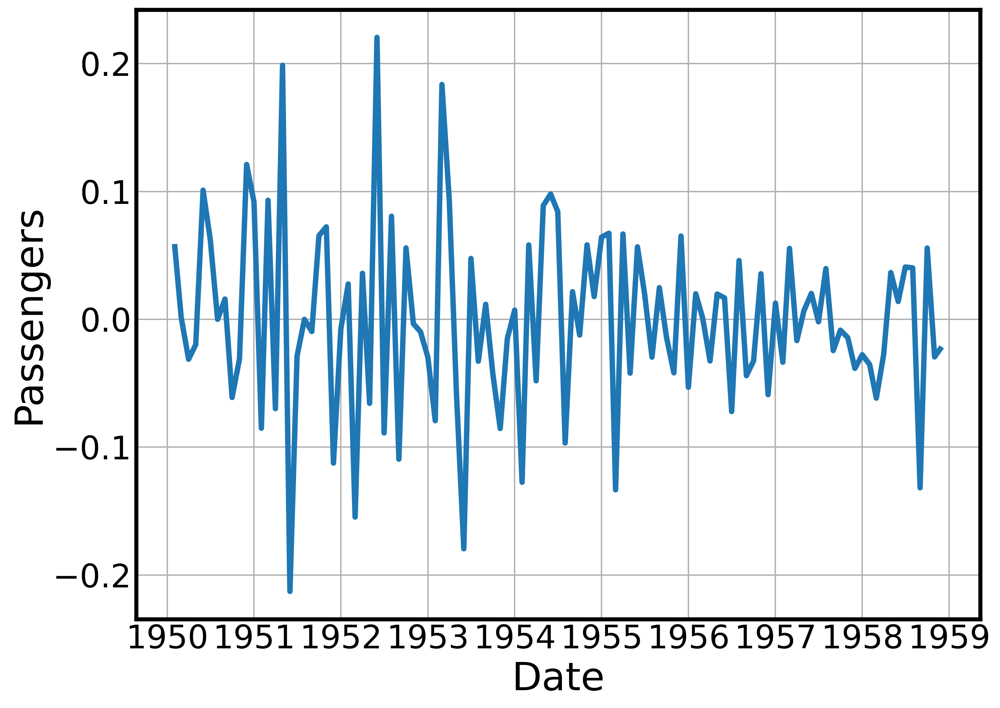

In [23]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['pass_box_diff1'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');
print(test_trend(airline['pass_box_diff1'].dropna())); # ряд стационарный

Шаг 4-5. Подбор параметров p, q, P, Q и выбор оптимальной модели по критерию Акаике

In [24]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
warnings.filterwarnings('ignore')

def calc_optimum_sarima(ts,
                        max_p,
                        max_P,
                        max_q,
                        max_Q,
                        d,
                        D): 
    """
    Подбор оптимальных гиперпараметров модели ARIMA с помощью критерия Акаике.
    Идет перебор всех вариантов (p,P,q,Q) в пределах (0,max_p)*(0,max_P)*(0,max_q)*(0,max_Q)
    
    """
    
    best_bic = float("inf")
    
    ps = range(0, max_p+1)
    qs = range(0, max_q+1)
    Ps = range(0, max_P+1)
    Qs = range(0, max_Q+1)
    parameters = product(ps, qs, Ps, Qs)
    parameters_list = list(parameters)
    
    print(len(parameters_list))
    
    results = []
    for param in parameters_list:
        #try except нужен, потому что на некоторых наборах параметров модель не обучается
        try:
            model=sm.tsa.SARIMAX(ts, 
                          order=(param[0], d, param[1]), 
                          seasonal_order=(param[2], D, param[3], 12)).fit(disp=-1)
        #выводим параметры, на которых модель не обучается и переходим к следующему набору
        except ValueError:
            print('wrong parameters:', param)
            continue
        aic = model.aic
        bic = model.bic
        #сохраняем лучшую модель, aic, параметры
        if bic < best_bic:
            best_model = model
            best_bic = aic
            best_param = param
        results.append([param, aic, bic]) 
    
    return results, best_model

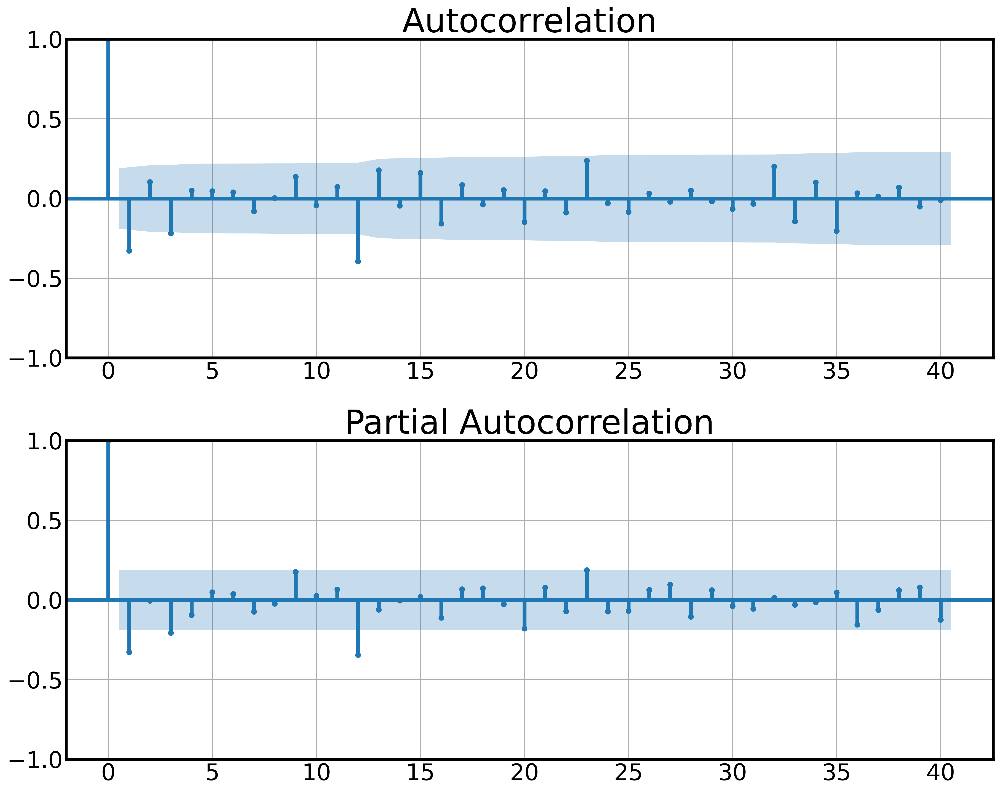

In [25]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(airline['pass_box_diff1'].dropna(),ax=ax[0],lags =40);
tsaplots.plot_pacf(airline['pass_box_diff1'].dropna(),ax=ax[1],lags =40);

In [26]:
# max_p - последний статзначимый лаг в частичной автокореляционной ф-и
# max_P - последний статзначимый сезонный лаг в частичной автокореляционной ф-и
# max_q - последний статзначимый лаг в автокореляционной ф-и
# max_Q - последний статзначимый сезонный лаг в автокореляционной ф-и
_, mod = calc_optimum_sarima(airline['pass_box'],
                        max_p = 1,
                        max_P = 1,
                        max_q = 1,
                        max_Q = 1,
                        d = 1,
                        D = 1)

16


Шаг 6. Оценка остатков

In [27]:
mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                           pass_box   No. Observations:                  120
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 12)   Log Likelihood                 148.616
Date:                            Mon, 06 May 2024   AIC                           -291.231
Time:                                    20:41:52   BIC                           -283.213
Sample:                                01-01-1949   HQIC                          -287.981
                                     - 12-01-1958                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3276      0.086     -3.790      0.000      -0.497      -0.158
ma.S.L12      -0.5087      0.104     -4.887      0.000      -0.713      -0.305
sigma2         0.0035      0.000      7.658      0.000       0.003       0.004
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 0.73
Prob(Q):                              0.96   Prob(JB):                         0.70
Heteroskedasticity (H):               0.43   Skew:                             0.15
Prob(H) (two-sided):                  0.01   Kurtosis:                         3.26
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [28]:
# проверка остатков говорит о наличии гетероскедастичности и отсутствии нормальность распределения
check_fit(mod.resid)

{'mean_resids': 0.024972947260530245,
 'mean_t': 0.45648573884345234,
 'mean_pval': 0.6488728068938772,
 'stationary_t': -23.434964916239586,
 'stationary_pval': 1.0,
 'autocor_pval': True,
 'norm_t': 0.20316600799560547,
 'norm_pval': 1.2089714939779756e-22,
 'heteroscedasticity_t': 4.189843843768999,
 'heteroscedasticity_pval': 0.04288786766334024,
 'check_result': False}

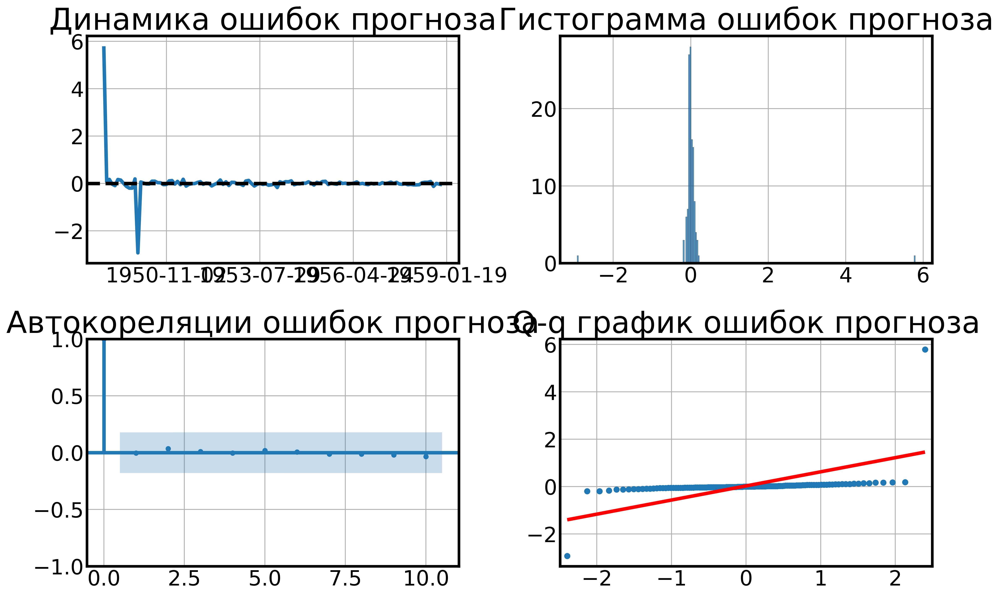

In [29]:
# из-за наличия только ма-части ошибка в первом лаге и первом сезонном лаге очень большие
plot_diagnostics(mod.resid.reset_index(),'Month',0)

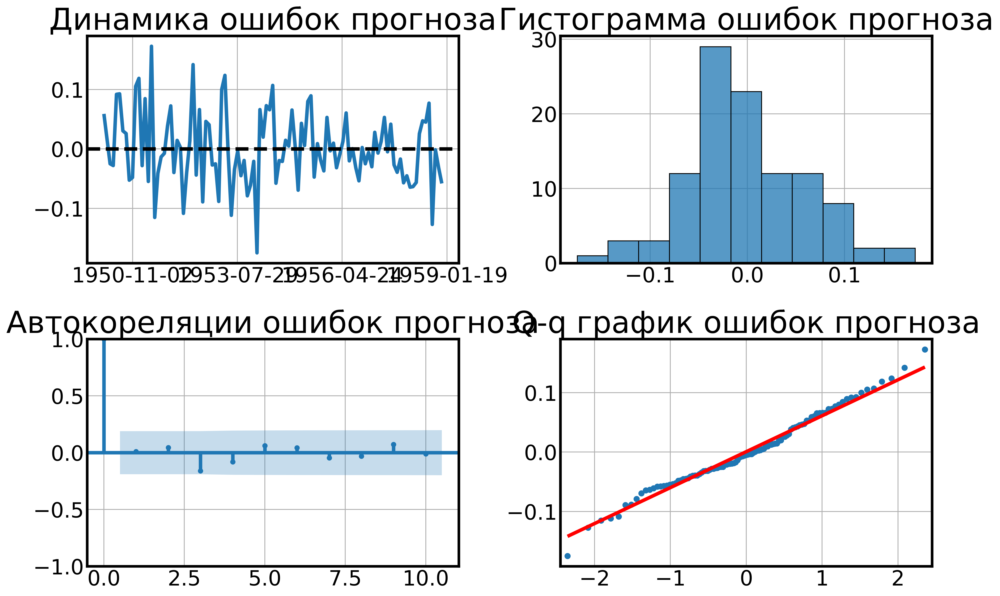

In [30]:
# избавившись от первых 12 наблюдений видим, что все стало ок
plot_diagnostics(mod.resid.iloc[13:].reset_index(),'Month',0)

In [31]:
# теперь остатки распределены нормально, но гетероскедастичность не ушла
check_fit(mod.resid.iloc[13:])

{'mean_resids': 0.0005609674454306903,
 'mean_t': 0.09546264018323279,
 'mean_pval': 0.9241276017764162,
 'stationary_t': -10.102790213718569,
 'stationary_pval': 1.0,
 'autocor_pval': True,
 'norm_t': 0.9884541034698486,
 'norm_pval': 0.49222302436828613,
 'heteroscedasticity_t': 5.2799913948015496,
 'heteroscedasticity_pval': 0.02355431256951557,
 'check_result': False}

оценка качества модели

In [32]:
airline_test['forecast'] = BC_inverse(mod.forecast(24),transformer.lambda_,mod.resid.std())

<Axes: xlabel='Month'>

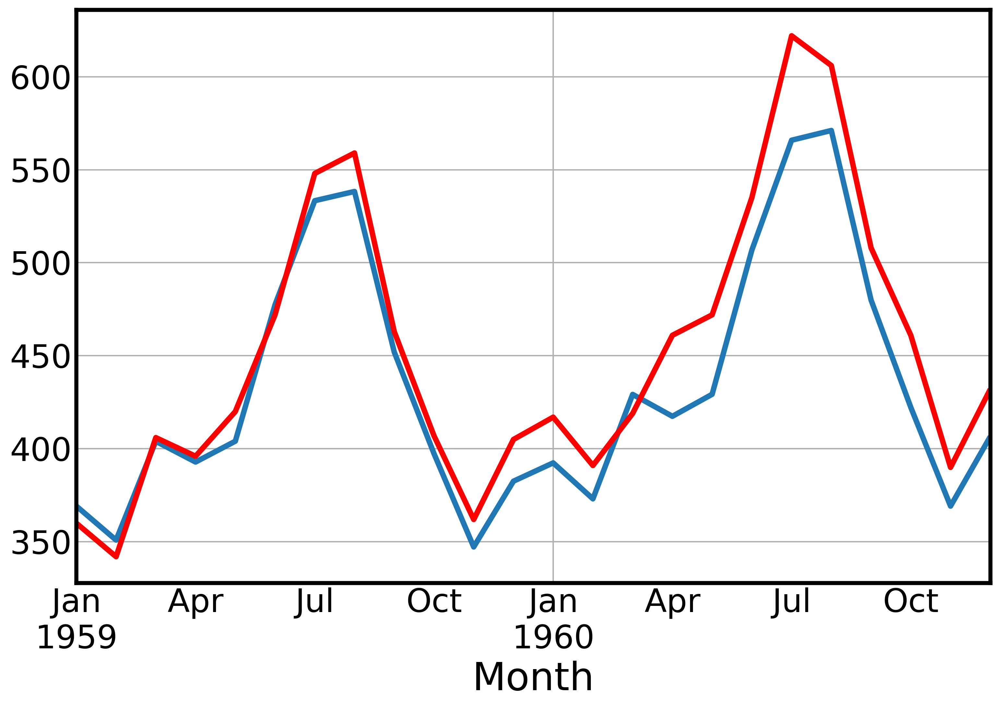

In [33]:
airline_test['forecast'].plot()
airline_test['Passengers'].plot(c='red')

In [34]:
metrics_report(airline_test['forecast'],airline_test['Passengers'])

,mean,median,quan_75,quan_95,std
maes,21.206738,19.297154,28.084332,43.422168,14.029457
maes_zero,54.494971,44.829700,75.438574,127.869792,37.435754
mapes,4.803702,4.528274,6.147791,9.944123,2.910451
mapes_zero,12.346442,10.495855,17.803892,23.971225,7.546858
r2,0.851985,0.851985,0.851985,0.851985,0.851985


## EMA

Простое скользящее среднее

\begin{align*}
  \text{Forecast equation}  && \hat{y}_{t+h|t} & = \ell_{t}\\
  \text{Smoothing equation} && \ell_{t}        & = \alpha y_{t} + (1 - \alpha)\ell_{t-1},
\end{align*}

In [35]:
from statsmodels.tsa.api import ExponentialSmoothing

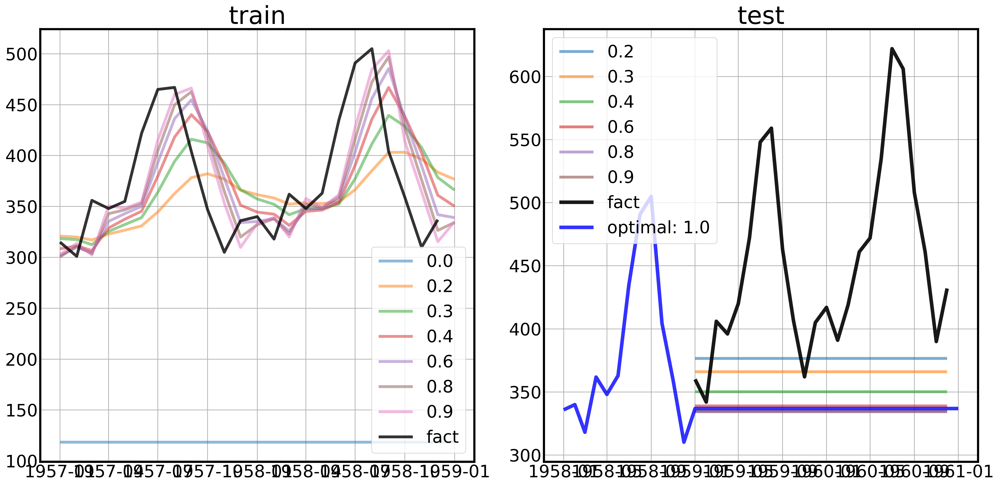

In [36]:
# посмотрим как выглядит решение с помощью ЭСС для различных альфа
# отобразим 24 наблюдения на трэйне и на тесте
fig,ax = plt.subplots(1,2,figsize=(20,10))
for alpha in np.arange(0,1,0.15):
    es1 = ExponentialSmoothing(airline['Passengers'],initialization_method='heuristic')
    es1 = es1.fit(smoothing_level=alpha)
    ax[0].plot(es1.predict(start=len(airline)-24,end= len(airline)),label=np.round(alpha,1),alpha = 0.5)
    
    if alpha>0:
        ax[1].plot(es1.forecast(len(airline_test)),
                   label=np.round(alpha,1),alpha = 0.6)
        
        
ax[0].plot(airline['Passengers'].iloc[-24:],alpha = 0.8,c='black',label='fact')
ax[0].set_title("train")
ax[1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
ax[1].set_title("test")

es1 = ExponentialSmoothing(airline['Passengers'],initialization_method='heuristic')
es1 = es1.fit()
ax[1].plot(es1.predict(start=len(airline)-12,end= len(airline)+24),
           label='optimal: ' + str(np.round(es1.params['smoothing_level'],1)),
           alpha = 0.8,
           linewidth = 5,
          c='blue')

ax[0].legend()
ax[1].legend()

на трейне решение представляет собой скользящее среднее с запаздыванием, на тесте - константу. Алгоритм ЭСС по ММП подобрал альфу, равную 1, что говорит о том, что ряд - нестационарный

In [37]:
# параметры модели - alpha и l0
es1.summary()

Dep. Variable:,Passengers,No. Observations:,120
Model:,ExponentialSmoothing,SSE,98475.027
Optimized:,True,AIC,809.208
Trend:,None,BIC,814.783
Seasonal:,None,AICC,809.556
Seasonal Periods:,None,Date:,"Mon, 06 May 2024"
Box-Cox:,False,Time:,20:50:44
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.9950000,alpha,True
initial_level,118.46667,l.0,False


In [38]:
# компоненты модели эсс
df = pd.DataFrame(
    np.c_[airline['Passengers'], es1.level, es1.trend, es1.season, es1.fittedvalues],
    columns=[r"$y_t$", r"$l_t$", r"$b_t$", r"$s_t$", r"$\hat{y}_t$"],
    index=airline.index,
)
df = df.append(es1.forecast(2).rename(r"$\hat{y}_t$").to_frame(), sort=True)
# прогноз: 𝑙𝑡 = alpha*𝑦𝑡+(1-alpha)*𝑙𝑡-1
df['forecast_check'] = 0.995*df[r"$y_t$"]+(1-0.995)*df[r"$l_t$"].shift(1)
df

,$\hat{y}_t$,$b_t$,$l_t$,$s_t$,$y_t$,forecast_check
1949-01-01,118.466667,0.0,112.032333,0.0,112.0,NaN
1949-02-01,112.032333,0.0,117.970162,0.0,118.0,117.970162
1949-03-01,117.970162,0.0,131.929851,0.0,132.0,131.929851
1949-04-01,131.929851,0.0,129.014649,0.0,129.0,129.014649
1949-05-01,129.014649,0.0,121.040073,0.0,121.0,121.040073
1949-06-01,121.040073,0.0,134.930200,0.0,135.0,134.930200
1949-07-01,134.930200,0.0,147.934651,0.0,148.0,147.934651
1949-08-01,147.934651,0.0,147.999673,0.0,148.0,147.999673
1949-09-01,147.999673,0.0,136.059998,0.0,136.0,136.059998
1949-10-01,136.059998,0.0,119.085300,0.0,119.0,119.085300


Модель Хольта-Уинтерса

Аддитивная:
\begin{align*}
  \hat{y}_{t+h|t} &= \ell_{t} + hb_{t} + s_{t+h-m(k+1)} \\
  \ell_{t} &= \alpha(y_{t} - s_{t-m}) + (1 - \alpha)(\ell_{t-1} + b_{t-1})\\
  b_{t} &= \beta^*(\ell_{t} - \ell_{t-1}) + (1 - \beta^*)b_{t-1}\\
  s_{t} &= \gamma (y_{t}-\ell_{t-1}-b_{t-1}) + (1-\gamma)s_{t-m},
\end{align*}

Мультипликативная:

\begin{align*}
  \hat{y}_{t+h|t} &= (\ell_{t} + hb_{t})s_{t+h-m(k+1)} \\
  \ell_{t} &= \alpha \frac{y_{t}}{s_{t-m}} + (1 - \alpha)(\ell_{t-1} + b_{t-1})\\
  b_{t} &= \beta^*(\ell_{t}-\ell_{t-1}) + (1 - \beta^*)b_{t-1}                \\
  s_{t} &= \gamma \frac{y_{t}}{(\ell_{t-1} + b_{t-1})} + (1 - \gamma)s_{t-m}.
\end{align*}

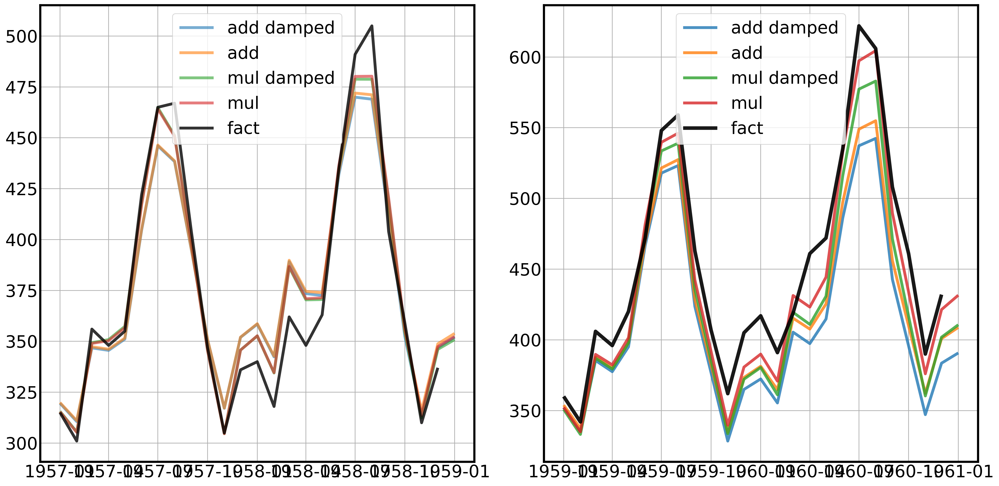

In [39]:
# посмотрим как выглядит решение с помощью ЭСС для различных гиперпараметров:
# тренд - аддитивный/мультипликативный, затухающий/не затухающий
# отобразим 24 наблюдения на трэйне и на тесте
fig,ax = plt.subplots(1,2,figsize=(20,10))
for trend, is_damped in product(["add", "mul"],[True,False]):
    es1 = ExponentialSmoothing(airline['Passengers'].resample("MS").sum(),
                               trend = trend,
                               seasonal = trend,
                               seasonal_periods = 12,
                               damped_trend = is_damped,
                               initialization_method='heuristic')
    es1 = es1.fit()
    ax[0].plot(es1.predict(start=len(airline)-24,end= len(airline)),
               label=trend+(" damped" if is_damped else ""),alpha = 0.6)
    ax[1].plot(es1.predict(start=len(airline),end= len(airline)+24),
               label=trend+(" damped" if is_damped else ""),alpha = 0.8)

ax[0].plot(airline['Passengers'].iloc[-24:],alpha = 0.8,c='black',label='fact')
ax[1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
ax[0].legend()
ax[1].legend()

сравнение аддитивной и мультипликативной моделей эсс

In [40]:
fit1 = ExponentialSmoothing(
    airline['Passengers'],
    seasonal_periods=12,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()
fit2 = ExponentialSmoothing(
    airline['Passengers'],
    seasonal_periods=12,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

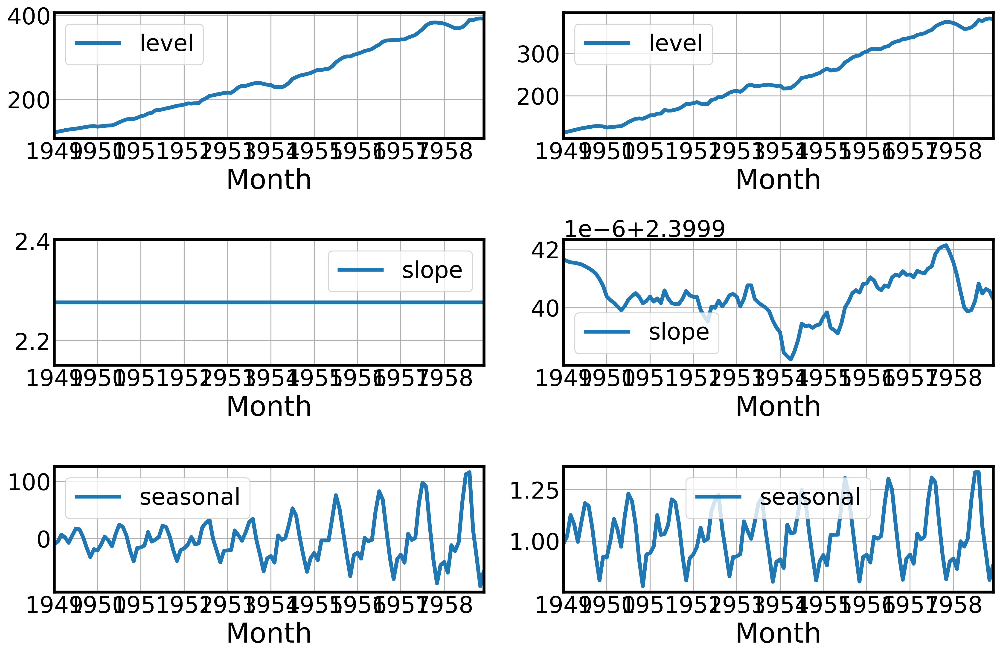

In [41]:
states1 = pd.DataFrame(
    np.c_[fit1.level, fit1.trend, fit1.season],
    columns=["level", "slope", "seasonal"],
    index=airline.index,
)
states2 = pd.DataFrame(
    np.c_[fit2.level, fit2.trend, fit2.season],
    columns=["level", "slope", "seasonal"],
    index=airline.index,
)
fig, [[ax1, ax4], [ax2, ax5], [ax3, ax6]] = plt.subplots(3, 2, figsize=(15, 10))
states1[["level"]].plot(ax=ax1)
states1[["slope"]].plot(ax=ax2)
states1[["seasonal"]].plot(ax=ax3)
states2[["level"]].plot(ax=ax4)
states2[["slope"]].plot(ax=ax5)
states2[["seasonal"]].plot(ax=ax6)
plt.show()

Мультипликативность учитывается в аддитивной модели за счёт изменение амплитуды сезонных компонент со временем.

оценка качества модели - ошибка в полтора раза меньше, чем у SARIMA

In [42]:
metrics_report(es1.forecast(24),airline_test['Passengers'])

,mean,median,quan_75,quan_95,std
maes,16.629379,15.655363,22.751842,27.567716,8.849154
maes_zero,61.815851,53.673184,96.125701,152.201276,45.710167
mapes,3.969324,3.785485,5.634691,6.882101,2.176218
mapes_zero,13.967221,13.325059,19.184525,28.589144,9.282928
r2,0.939628,0.939628,0.939628,0.939628,0.939628


За счет мультипликативности модель ЭСС хорошо описывает нестационарные ряды с нелинейным трендом или мультипликативной сезонностью

## Unobserved components

Про все семейство моделей Ненаблюдаемых компонент можно почитать по ссылке ниже:

https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.structural.UnobservedComponents.html

Общая формула:
$y_t = \mu_t + \gamma_t + c_t + \varepsilon_t$,

где $\mu_t$ - тренд, $\gamma_t$ - сезонность, $c_t$ - циклическая компонента, $\varepsilon_t$ - ошибка.

In [43]:
from statsmodels.tsa.statespace.api import ExponentialSmoothing as expsmoothkalman
from statsmodels.tsa.api import ExponentialSmoothing as expsmooth
from statsmodels.tsa.api import UnobservedComponents

Будем рассматривать следующие модели тренда:
* fixed slope
\begin{split}y_t &= \mu_t \\
\mu_t &= \mu_{t-1} + \beta\end{split}
* Deterministic trend
\begin{align*}
y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta
\end{align*}
* Local linear deterministic trend
\begin{split}y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta + \eta_t\end{split}
* Local linear trend
\begin{split}y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta_{t-1} + \eta_t \\
\beta_t &= \beta_{t-1} + \zeta_t\end{split}

In [44]:
# к ним для оценки добавим мультипликативное ЭСС и ЭСС с фильтром Калмана
# инициализируем список с зафиксированными параметрами модели и их названием
# второй параметр (True,False) отвечает за то, принтится ли лог обучения при взове метода fit (чтобы его отключить)
models = [("ets_kalm",
           True,
           lambda x: expsmoothkalman(x, 
                                     seasonal  = 12,
                                     trend = True,
                                     initialization_method='heuristic',)),
          ("ets",
           False,
           lambda x: expsmooth(x, 
                               seasonal_periods = 12,
                               trend = "mul",
                               seasonal="mul",
                               initialization_method='heuristic')),
          ("unobs_fixed_slope",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "fixed slope",
                                         irregular=False, 
                                         initialization_method='heuristic',)),
          ("unobs_deterministic_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "deterministic trend",
                                         irregular=True, 
                                         initialization_method='heuristic',)),
          ("unobs_local_linear_deterministic_trend",
           True,
           lambda x: UnobservedComponents(x, 
                                          seasonal  = 12,  
                                          level  = "local linear deterministic trend",
                                          irregular=True, 
                                          initialization_method='heuristic',)),
          ("unobs_local_linear_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "local linear trend",
                                         irregular=True, 
                                         initialization_method='heuristic',))]

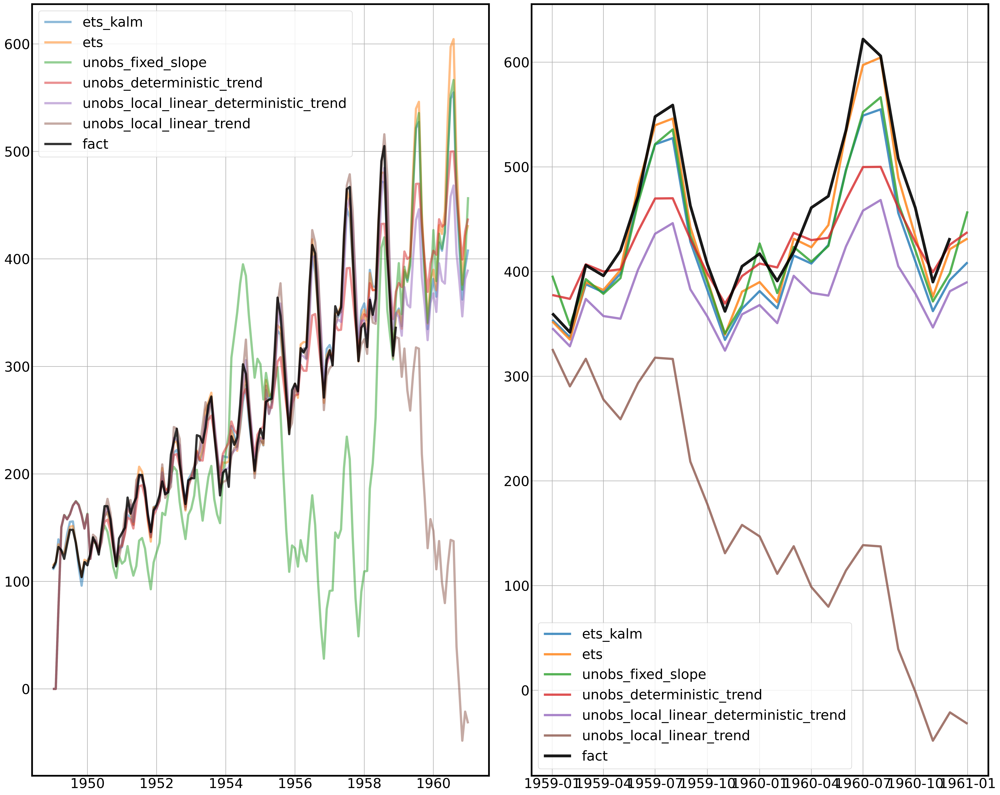

In [45]:
# посмотрим как выглядит решение с помощью ЭСС для различных гиперпараметров:
# тренд - аддитивный/мультипликативный, затухающий/не затухающий
# отобразим все наблюдения на трэйне и на тест
fig,ax = plt.subplots(1,2,figsize=(25,20))
for label,disp,model in models:
    es1 = model(airline['Passengers'].resample("MS").sum())
    if disp:
        es1 = es1.fit(disp=0);
    else:
         es1 = es1.fit();
    ax[0].plot(es1.predict(start=0,end= len(airline)+24),alpha = 0.5,label=label)
    ax[1].plot(es1.predict(start=len(airline),end= len(airline)+24),alpha = 0.8,label=label)

ax[0].plot(airline['Passengers'],alpha = 0.8,c='black',label='fact')
ax[1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
ax[0].legend()
ax[1].legend()

Можно отметить несколько вещей. Во-первых, инициализация параметров затрагивает первые 12 точек - в них модели хуже описывают обучающую выборку. Во-вторых, за счёт отсутствия мультипликативности модели ненаблюдаемых компонент (модели пространства состояний) перформят хуже, чем мультипликативное ЭСС, причем, чем больше мы увеличиваем неопределенность, тем больше у нас ошибка, т.к. у нас можно сказать "без сомнений" ярко выраженный положительный тренд 

In [46]:
# те же модели, но без ЭСС
models = [("unobs_fixed_slope",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "fixed slope",
                                         irregular=False, 
                                         initialization_method='heuristic',)),
          ("unobs_deterministic_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         stochastic_seasonal=True,
                                         level  = "deterministic trend",
                                         irregular=True, 
                                         initialization_method='heuristic',)),
          ("unobs_local_linear_deterministic_trend",
           True,
           lambda x: UnobservedComponents(x, 
                                          seasonal  = 12,  
                                          level  = "local linear deterministic trend",
                                          irregular=True, 
                                          initialization_method='heuristic',)),
          ("unobs_local_linear_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "local linear trend",
                                         irregular=True, 
                                         initialization_method='heuristic',))]

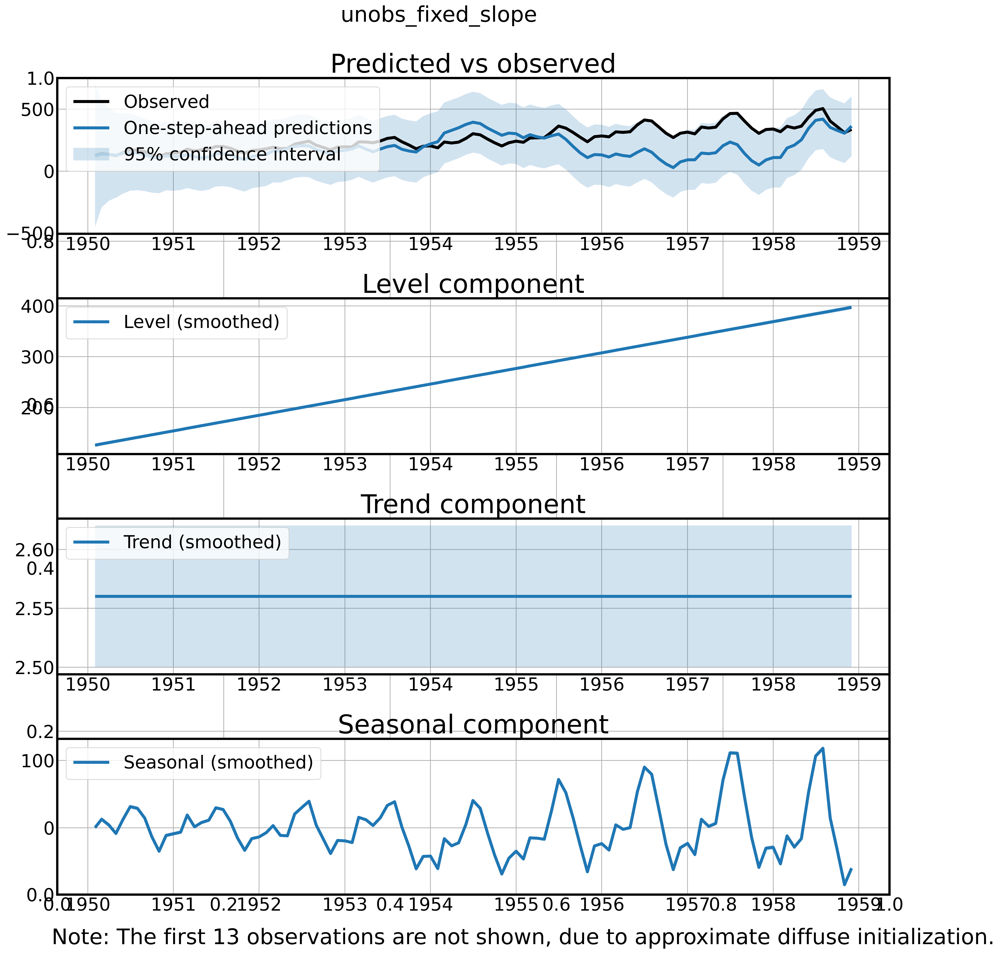

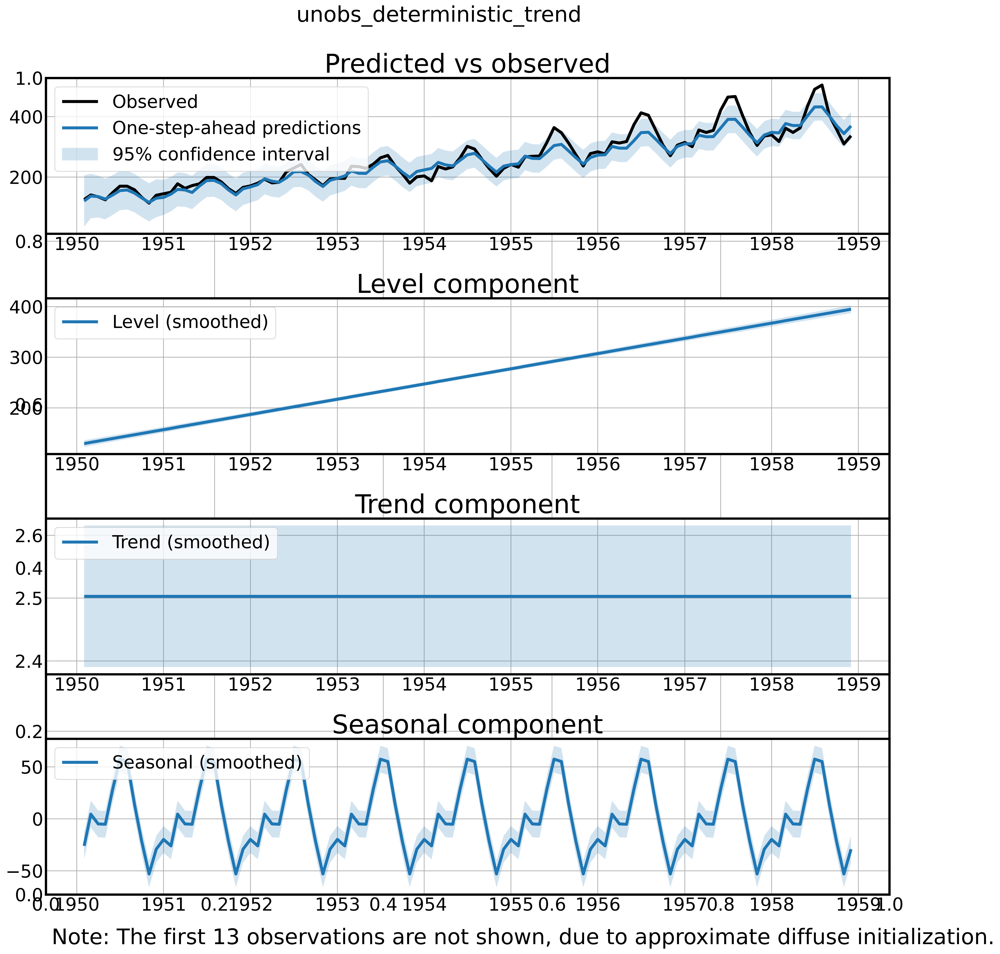

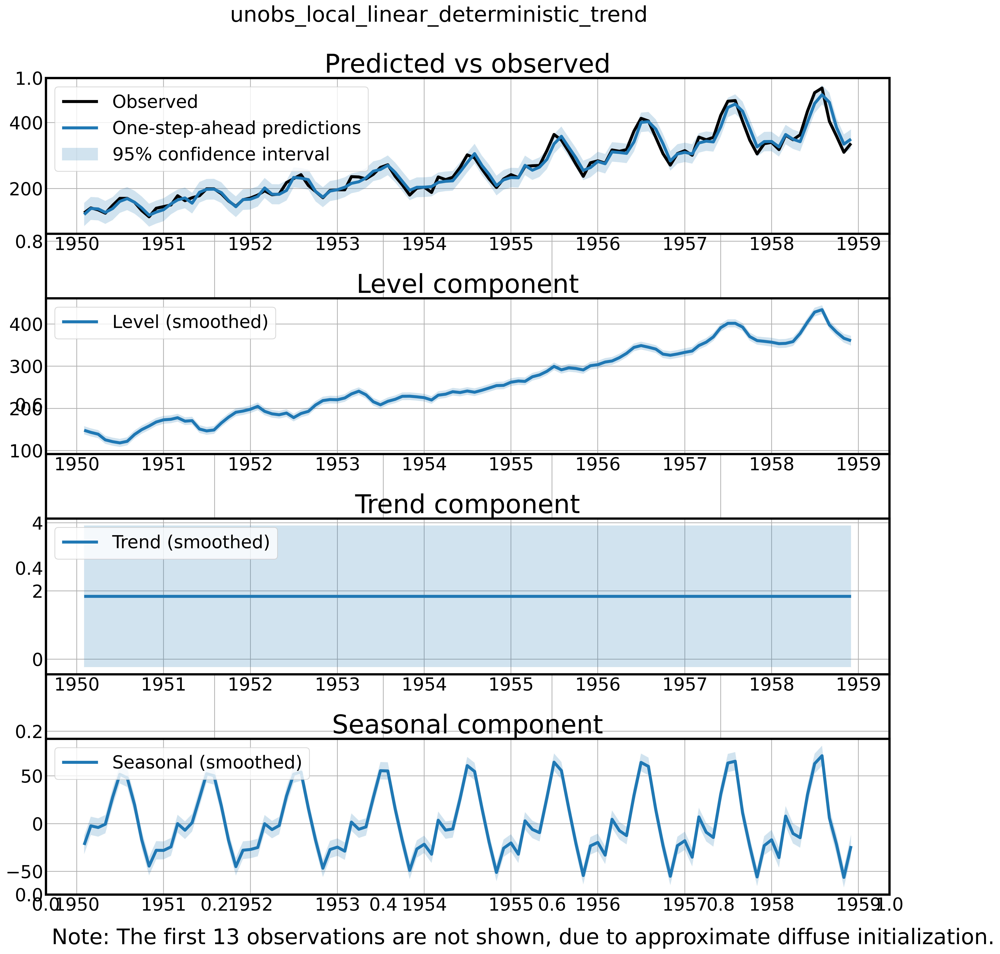

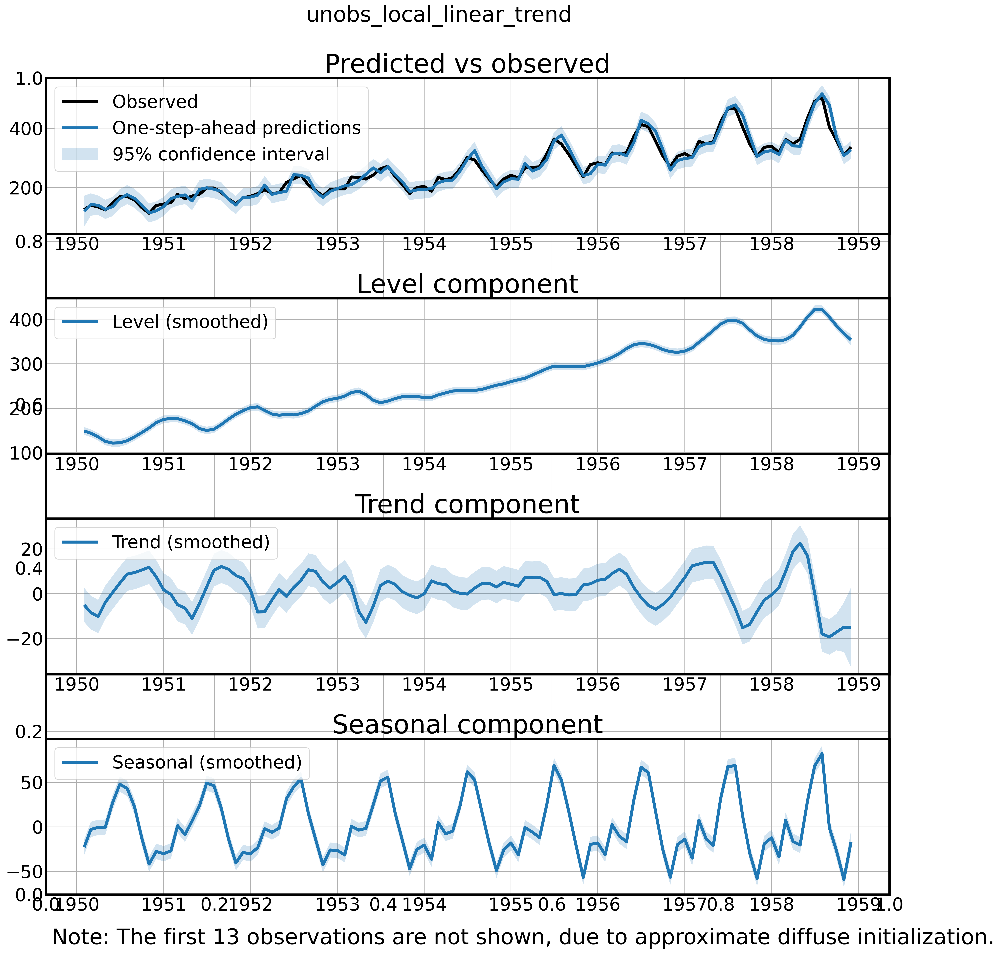

In [47]:
# посмотрим на графики их компонент
for label,disp,model in models:
    es1 = model(airline['Passengers'].resample("MS").sum())
    if disp:
        es1 = es1.fit(disp=0);
    else:
         es1 = es1.fit();
    
    
    fig,ax = plt.subplots(1,1,figsize=(18,18))
    es1.plot_components(fig=fig, legend_loc='upper left');
    fig.suptitle(label)
    

При построении софт автоматически убирает первые 13 наблюдений, где была большая ошибка. Тренд варьируется только для последней модели, где его график выглядит как случайное блуждание. 

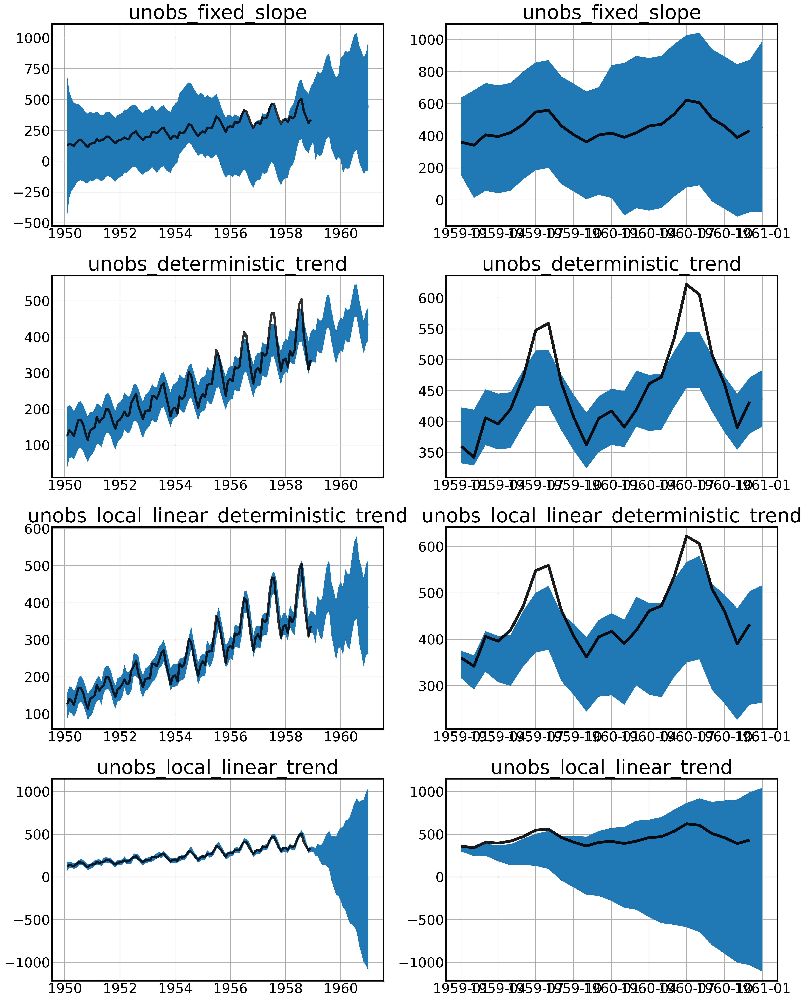

In [48]:
# теперь посмотрим на прогнозы и доверительные интервалы 
fig,ax = plt.subplots(len(models),2,figsize=(20,25))

for i,md in enumerate(models):
    label,disp,model = md
    es1 = model(airline['Passengers'].resample("MS").sum())
    if disp:
        es1 = es1.fit(disp=0);
    else:
         es1 = es1.fit();
    
    preds = es1.get_prediction(start=0,end= len(airline)+24)
    preds_sum = preds.summary_frame()
    
    
    ax[i][0].plot(preds_sum.iloc[13:,]['mean'],alpha = 0.5,label=label)
    ax[i][0].fill_between(preds_sum.iloc[13:,].index, 
                          preds_sum.iloc[13:,].mean_ci_lower, 
                          preds_sum.iloc[13:,].mean_ci_upper)
    
    
    
    ax[i][1].plot(preds_sum.iloc[len(airline):,]['mean'],alpha = 0.8,label=label)
    ax[i][1].fill_between(preds_sum.iloc[len(airline):,].index, 
                       preds_sum.iloc[len(airline):,].mean_ci_lower, 
                       preds_sum.iloc[len(airline):,].mean_ci_upper)

    ax[i][0].plot(airline.iloc[13:,]['Passengers'],alpha = 0.8,c='black',label='fact')
    ax[i][1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
    
    ax[i][0].set_title(label)
    ax[i][1].set_title(label)

величина доверительного интервала зависит от двух вещей: сколько у нас случайных блужданий в компонентах и от ошибки на трэйне. Нужно соблюдать баланс: чтобы д.и., с одной стороны, не был слишком большим, при этом чтобы 95% наблюдений попадало в него

In [49]:
es1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            Unobserved Components Results                            
=====================================================================================
Dep. Variable:                    Passengers   No. Observations:                  120
Model:                    local linear trend   Log Likelihood                -445.178
                   + stochastic seasonal(12)   AIC                            898.356
Date:                       Mon, 06 May 2024   BIC                            909.048
Time:                               21:09:16   HQIC                           902.690
Sample:                           01-01-1949                                         
                                - 12-01-1958                                         
Covariance Type:                         opg                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
sigma2.irregular  1.093e-08     21.596   5.06e-10      1.000     -42.328      42.328
sigma2.level       1.84e-08     52.937   3.48e-10      1.000    -103.754     103.754
sigma2.trend        50.7414     20.595      2.464      0.014      10.375      91.108
sigma2.seasonal     16.6074      4.650      3.572      0.000       7.494      25.721
===================================================================================
Ljung-Box (L1) (Q):                   5.72   Jarque-Bera (JB):               112.03
Prob(Q):                              0.02   Prob(JB):                         0.00
Heteroskedasticity (H):               3.78   Skew:                            -1.31
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.27
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Модели пространства состояний, в первую очередь, применяются для байесовского а/б тестирования 

## Prophet

$y(t) = g(t) + s(t) + h(t) + \epsilon_{t}$, где

$g(t)$ - Trend, models non-periodic changes.

$s(t)$ - Seasonality, represents periodic changes.

$h(t)$ - Holidays component, contributes information about holidays and events.

In [50]:
from prophet import Prophet

В качестве данных будем использовать данные о продажах в магазине испанского ритейлера. Попробуем научиться предсказывать продажи данного ритейлера по стране. Помимо данных о продажах, у нас также есть данные о праздниках в Испании за эти же даты

In [51]:
df_transactions = pd.read_csv('data/transactions.csv')
df_holidays_events = pd.read_csv('data/holidays_events.csv')

In [52]:
df_transactions.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [53]:
# агрегируем данные по стране
df_transactions['date'] = pd.to_datetime(df_transactions['date'])
transactions = df_transactions.groupby('date')['transactions'].sum()

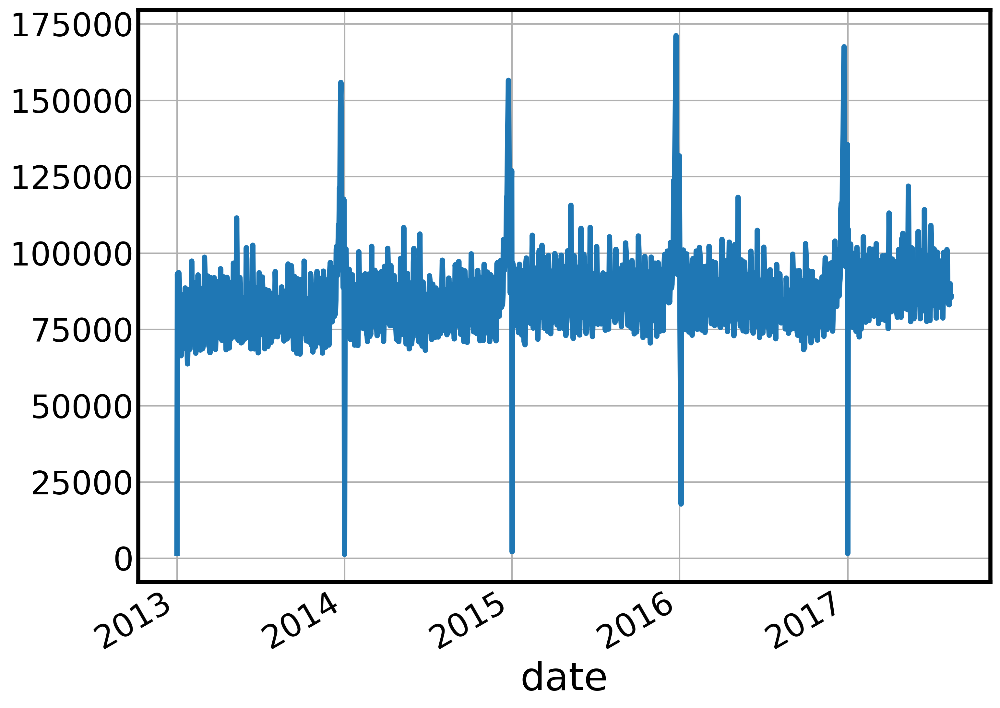

In [54]:
transactions.plot();

In [55]:
# для профета важно, чтобы df содержал как минимум 2 колонки: ds - время и y - таргет
transactions = pd.DataFrame(transactions).reset_index()
transactions.columns = ['ds', 'y']
transactions

,ds,y
0,2013-01-01,770
1,2013-01-02,93215
2,2013-01-03,78504
3,2013-01-04,78494
4,2013-01-05,93573
...,...,...
1677,2017-08-11,89551
1678,2017-08-12,89927
1679,2017-08-13,85993
1680,2017-08-14,85448


In [56]:
# fit_predict для профета реализовывается в несколько строчек
# по умолчанию профет оценивает частоту данных и моделирует соответствующие сезонности
# в этом примере он моделирует недельную и годовую сезонности
m = Prophet()
m.fit(transactions)
future = m.make_future_dataframe(periods=365) # утила для создания датафрэйма с будущими датами
forecast = m.predict(future)
forecast.head(14)

21:10:44 - cmdstanpy - INFO - Chain [1] start processing
21:10:44 - cmdstanpy - INFO - Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2013-01-01,77956.353515,75702.590839,96112.171213,77956.353515,77956.353515,8035.537348,8035.537348,8035.537348,-4840.283817,-4840.283817,-4840.283817,12875.821165,12875.821165,12875.821165,0.0,0.0,0.0,85991.890863
1,2013-01-02,77965.986515,75351.181026,95693.321939,77965.986515,77965.986515,7128.441760,7128.441760,7128.441760,-3741.016576,-3741.016576,-3741.016576,10869.458336,10869.458336,10869.458336,0.0,0.0,0.0,85094.428275
2,2013-01-03,77975.619514,68916.283254,89471.330009,77975.619514,77975.619514,1617.863252,1617.863252,1617.863252,-7236.522083,-7236.522083,-7236.522083,8854.385335,8854.385335,8854.385335,0.0,0.0,0.0,79593.482766
3,2013-01-04,77985.252514,72741.701135,93223.314446,77985.252514,77985.252514,5201.181985,5201.181985,5201.181985,-1661.243247,-1661.243247,-1661.243247,6862.425232,6862.425232,6862.425232,0.0,0.0,0.0,83186.434499
4,2013-01-05,77994.885514,86115.337611,106193.607294,77994.885514,77994.885514,17876.911479,17876.911479,17876.911479,12952.783250,12952.783250,12952.783250,4924.128229,4924.128229,4924.128229,0.0,0.0,0.0,95871.796993
5,2013-01-06,78004.518513,78787.955874,98895.979682,78004.518513,78004.518513,10621.767883,10621.767883,10621.767883,7553.609437,7553.609437,7553.609437,3068.158446,3068.158446,3068.158446,0.0,0.0,0.0,88626.286396
6,2013-01-07,78014.151513,66101.885610,86971.219820,78014.151513,78014.151513,-1706.593848,-1706.593848,-1706.593848,-3027.326965,-3027.326965,-3027.326965,1320.733117,1320.733117,1320.733117,0.0,0.0,0.0,76307.557665
7,2013-01-08,78023.784513,63086.129301,83020.077117,78023.784513,78023.784513,-5135.156972,-5135.156972,-5135.156972,-4840.283817,-4840.283817,-4840.283817,-294.873156,-294.873156,-294.873156,0.0,0.0,0.0,72888.627540
8,2013-01-09,78033.417512,62890.248161,82601.148055,78033.417512,78033.417512,-5499.764802,-5499.764802,-5499.764802,-3741.016576,-3741.016576,-3741.016576,-1758.748225,-1758.748225,-1758.748225,0.0,0.0,0.0,72533.652711
9,2013-01-10,78043.050512,57953.123370,78510.353017,78043.050512,78043.050512,-10291.199499,-10291.199499,-10291.199499,-7236.522083,-7236.522083,-7236.522083,-3054.677416,-3054.677416,-3054.677416,0.0,0.0,0.0,67751.851013


RMSE: 7904.392274


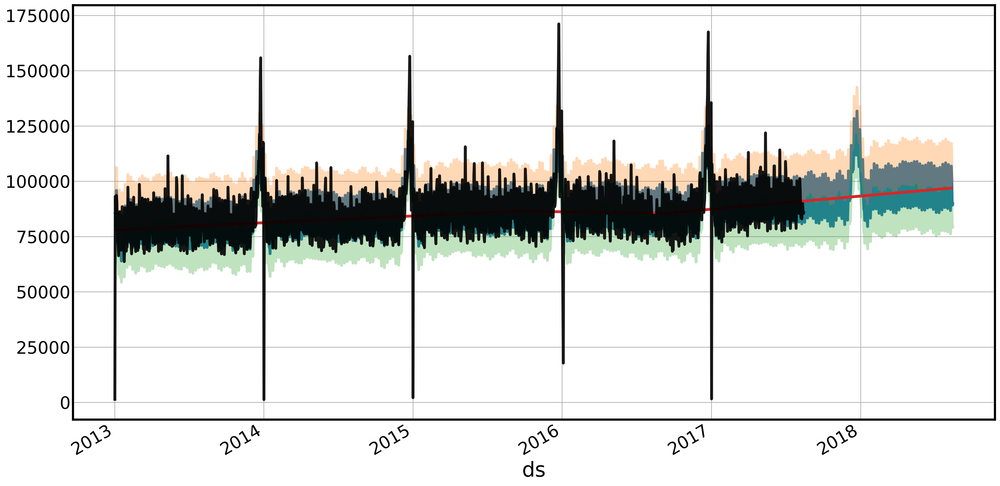

In [57]:
# график факта и прогноза на год вперед с доверительным интервалом и трендом
print('RMSE: %f' % np.sqrt(np.mean((forecast.loc[:1682, 'yhat']-transactions['y'])**2)) )
forecast.set_index("ds",inplace=True)
plt.figure(figsize=(20,10))
forecast.yhat.plot()
forecast.yhat_upper.plot(alpha=0.3)
forecast.yhat_lower.plot(alpha=0.3)
forecast.trend.plot()
plt.plot(transactions.ds.values,transactions.y.values,c='black',alpha=0.9)

In [58]:
m.params

OrderedDict([('lp__', array([[4325.37]])),
             ('k', array([[0.0949405]])),
             ('m', array([[0.455435]])),
             ('delta',
              array([[ 5.32101e-08, -5.22982e-05, -1.99841e-03, -7.43691e-03,
                      -2.79774e-03, -2.07902e-07,  1.20286e-08, -5.46793e-09,
                      -3.62347e-08,  3.72048e-07,  3.25386e-08,  9.19205e-09,
                      -1.50535e-07, -4.76709e-08, -9.56027e-08, -1.72704e-05,
                      -2.04494e-05, -7.18222e-02, -3.71809e-02,  1.69451e-08,
                      -1.75346e-07, -5.89552e-08,  1.00414e-07,  6.70348e-03,
                       1.79915e-01]])),
             ('sigma_obs', array([[0.0461802]])),
             ('beta',
              array([[ 0.00329743,  0.0161383 , -0.00674105,  0.0150504 , -0.0102194 ,
                       0.0178828 , -0.0138042 ,  0.0100544 , -0.0140374 ,  0.0077354 ,
                      -0.0148939 ,  0.00693768, -0.0131626 ,  0.00418405, -0.0128234 ,
          

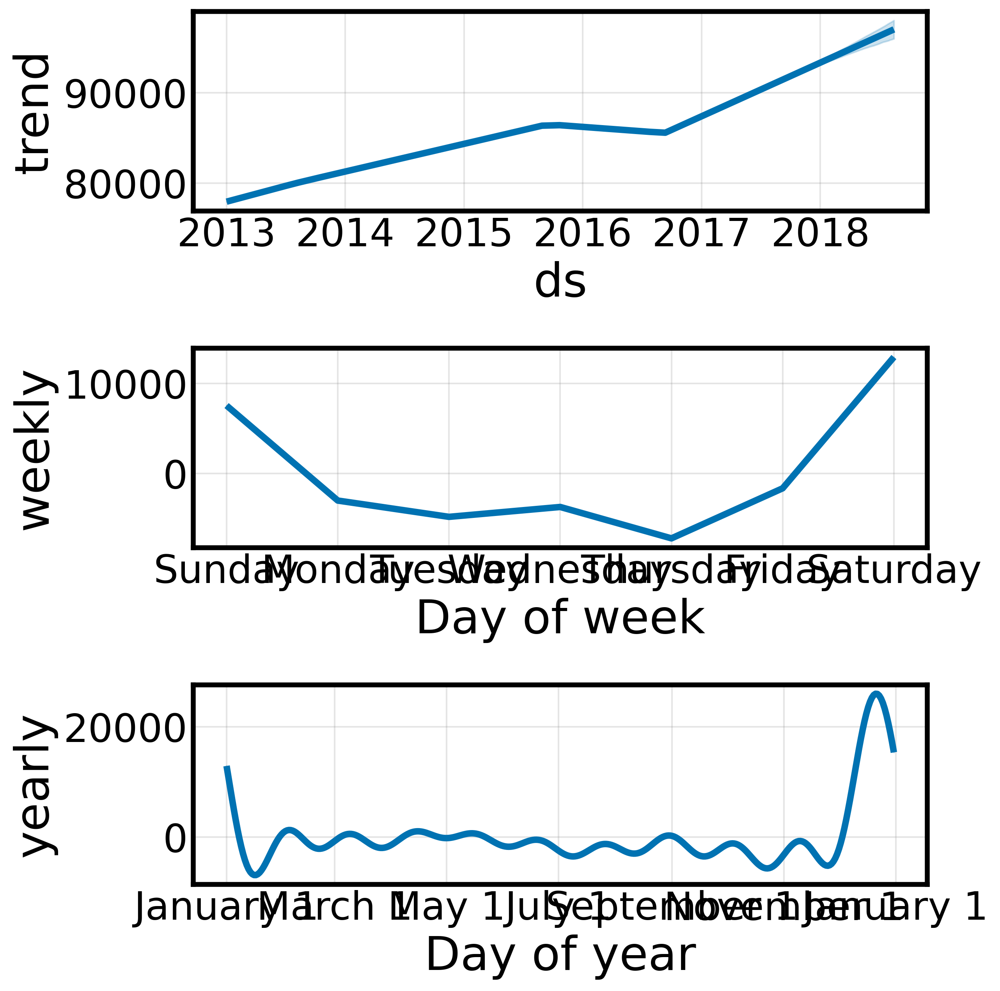

In [59]:
# график основных компонент 
# сезонности моделируются рядами фурье
m.plot_components(forecast.reset_index());

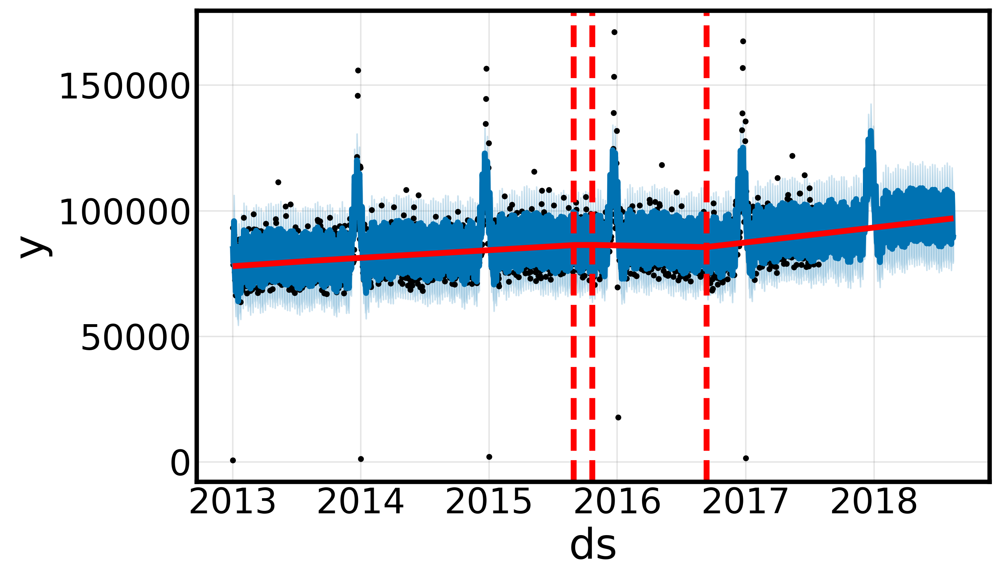

In [60]:
# в качестве тренда профет использует кусочно-линейную функцию 
# на графики показаны выбранные точки излома
from prophet.plot import add_changepoints_to_plot
fig = m.plot(forecast.reset_index())
a = add_changepoints_to_plot(fig.gca(), m, forecast.reset_index())

Теперь оценим качество на кросс-валидации. Попробуем задать следующую кросс-валидацию - с шагом 1 месяц (т.е. с переменным шагом по дням - 30/31/28 дней) и с разницей между концом обучения и месяцем предикта - 1 месяц (т.е. по данным декабря прогнозируем на февраль). К сожалению, в модуле ExpandingWindowSplitter из библиотеки sktime нельзя сделать сплитер с разными шагами по времени, поэтому мы напишем свой, совместимый с функцией evaluate из той же библиотеки sktime.

In [61]:
from sktime.forecasting.fbprophet import Prophet as prophet_sktime
from sktime.forecasting.base import ForecastingHorizon

In [63]:
from sktime.split.base._base_splitter import BaseSplitter
from pandas.tseries.frequencies import to_offset
from typing import Union
class TimeseriesSplit(BaseSplitter):
    def __init__(self,
                 start_dt: pd.datetime,
                 end_dt: pd.datetime,
                 freq: str,
                 h:int,
                 n_splits: int=None,
                 split_step: int = None,
                 gap = 0):
        """
        Класс для временной кросс-валидации по заданной частоте freq.
        Помимо частоты, задается либо число шагов валидации (n_splits), 
        либо шаг валидации (split_step)

        :param start_dt: дата, откуда начинаем валидацию
        :param end_dt: дата, где валидация заканчивается 
        :param freq: pandas offset frequency
        (см. https://pandas.pydata.org/pandas-docs/version/1.5/user_guide/timeseries.html#offset-aliases)
        :param h: горизонт прогнозирования 
        :param n_splits: число шагов валидации 
        :param split_step: шаг валидации
        :param gap: промежуток между концом обучения и датой валидации
        :return:
        
        """
        
        
        self.start_dt = start_dt
        self.end_dt = end_dt
        
        self.freq = freq
        
        if n_splits is None and split_step is None:
            raise "You should either define n_splits or split_step"
        
        if n_splits is None:
            #кол-во сплитов=кол-во дат между start_dt и end_dt с частотой freq/шаг валидации
            self.n_splits = int(np.ceil(1.0*len(pd.date_range(start=start_dt,
                                                              end=end_dt,
                                                              freq=freq))/split_step))
            self.split_step = split_step
        else:
            #шаг валидации=кол-во дат между start_dt и end_dt с частотой freq/кол-во сплитов
            self.split_step = int(np.ceil(1.0*len(pd.date_range(start=start_dt,
                                                                end=end_dt,
                                                                freq=freq))/n_splits))
            self.n_splits = n_splits
        
        self.gap = gap
        self.h = h
        self.fh = None

    # split для sklearn - def split(self, X, y, groups = None):
    def split(self, X, y=None, groups=None):
        """
        Функция-генератор разбиения выборки на train и test
        """
        if isinstance(X,pd.DatetimeIndex):
                dates_index = X
        else:
                dates_index = pd.to_datetime(X.index)
                
        for i in range(self.n_splits):
            # в обучение попадает от start_dt до текущего шага - гап
            dt_train = self.start_dt + to_offset(self.freq)*(i*self.split_step-self.gap)
            # в тест - от текущего шага до текущего шага + горизонт прогнозирования
            dt_start_test = dt_train + to_offset(self.freq)*(self.gap)
            dt_end_test = dt_train + to_offset(self.freq)*(self.h+self.gap)
            
            # возвращаем индексы в масивах
            trix = np.where(dates_index<dt_train)[0]
            tsix = np.where((dates_index>=dt_start_test) &\
                            (dates_index<dt_end_test))[0]
            
            
            yield trix, tsix

    def print_dates(self,y):
        """
        Вспомогательная функция для проверки корректности алгоритма
        """
        
        dates_index = pd.to_datetime(y.index)
        for i in range(self.n_splits):
            # в обучение попадает от start_dt до текущего шага - гап
            dt_train = self.start_dt + to_offset(self.freq)*(i*self.split_step-self.gap)
            # в тест - от текущего шага до текущего шага + горизонт прогнозирования
            dt_start_test = dt_train + to_offset(self.freq)*(self.gap)
            dt_end_test = dt_train + to_offset(self.freq)*(self.h+self.gap)
            
            # возвращаем индексы в масивах
            trix = np.where(dates_index<dt_train)[0]
            tsix = np.where((dates_index>=dt_start_test) &\
                            (dates_index<dt_end_test))[0]
            
            print (dt_train,  dt_start_test, dt_end_test, len(trix), len(tsix))
    
    
    
    def get_n_splits(self, X, y, groups=None):
        """
        Вспомогательная функция для совместимости с sklearn
        """
        return self.n_splits

In [64]:
tss = TimeseriesSplit(pd.to_datetime('2017-06-01'),
                pd.to_datetime('2017-08-15'),
                freq='MS',
                h=1,
                split_step = 1,
                gap=1)

In [65]:
transactions_series = transactions.set_index("ds").resample("D").sum().y

In [66]:
# прогнозируем на месяц позже окончания обучения
tss.print_dates(transactions_series,)

2017-05-01 00:00:00 2017-06-01 00:00:00 2017-07-01 00:00:00 1581 30
2017-06-01 00:00:00 2017-07-01 00:00:00 2017-08-01 00:00:00 1612 31
2017-07-01 00:00:00 2017-08-01 00:00:00 2017-09-01 00:00:00 1642 15


In [67]:
forecaster = prophet_sktime()

In [68]:
# убираем ненужные принты
import warnings
warnings.simplefilter("ignore")
warnings.simplefilter("ignore", DeprecationWarning)
warnings.simplefilter("ignore", FutureWarning)

import logging

logging.getLogger('prophet').setLevel(logging.ERROR)

In [69]:
df1 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True)

21:19:44 - cmdstanpy - INFO - Chain [1] start processing
21:19:44 - cmdstanpy - INFO - Chain [1] done processing
21:19:44 - cmdstanpy - INFO - Chain [1] start processing
21:19:44 - cmdstanpy - INFO - Chain [1] done processing
21:19:45 - cmdstanpy - INFO - Chain [1] start processing
21:19:45 - cmdstanpy - INFO - Chain [1] done processing


In [70]:
df1.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.044403,0.467636,0.067400,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,2017-06-01 77773.334972 2017-06-02 82689...
1,0.038084,0.399393,0.066746,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,2017-07-01 99103.837018 2017-07-02 924...
2,0.053097,0.365456,0.065791,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,2017-08-01 83149.607415 2017-08-02 836...


In [72]:
# убеждаемся, что временные промежутки указаны верно
df1.iloc[0].y_train.tail()

ds
2017-04-26     84709
2017-04-27     78971
2017-04-28     87474
2017-04-29    104870
2017-04-30     96514
Freq: D, Name: y, dtype: int64

In [73]:
df1y_test = pd.concat([x for x in df1.y_test.values])
df1y_pred = pd.concat([x for x in df1.y_pred.values])

оценка качества модели - медиана апе меньше 4%

In [74]:
metrics_report(df1y_test,
                   df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4027.586701,2925.318976,5993.009163,10742.878854,3652.844569
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.354149,3.293633,6.634540,11.432292,3.685203
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.550375,0.550375,0.550375,0.550375,0.550375


<Axes: xlabel='ds'>

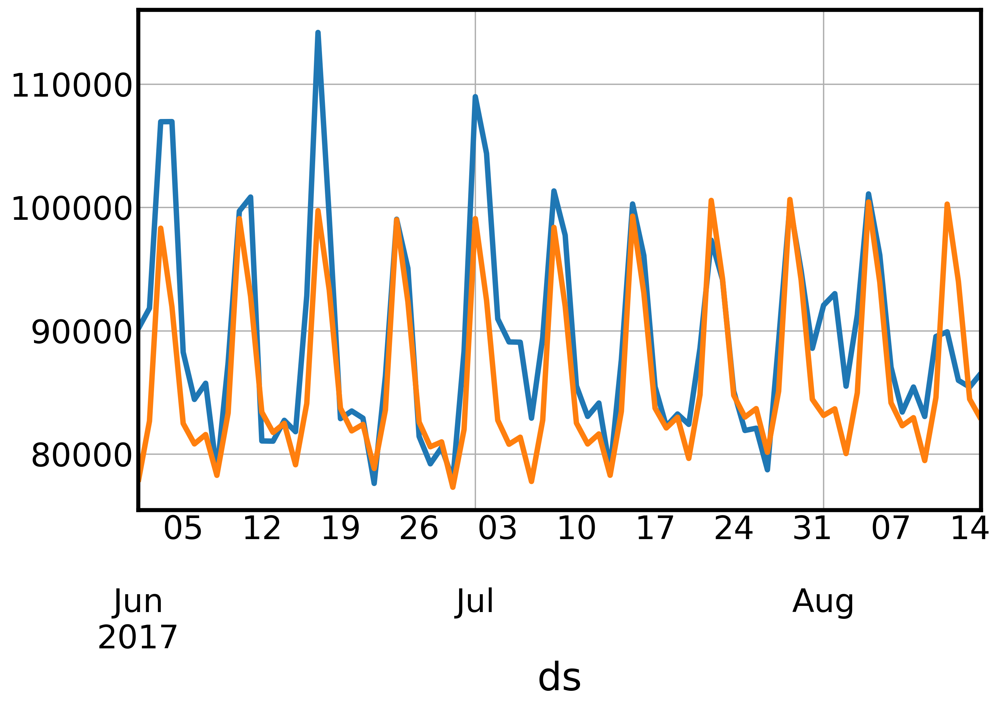

In [75]:
df1y_test.plot()
df1y_pred.plot()

давайте теперь посмотрим, что можно сделать, чтобы улучшить этот прогноз

для начала давайте добавим информацию о праздниках

In [76]:
df_holidays_events.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [77]:
# для праздников есть специальный формат датафрэйма, куда входят ds (время),
# holiday - название праздника, lower_window и upper_window - дней до и после
# праздника, когда действует этот эффект
holidays = df_holidays_events[df_holidays_events['transferred'] == False][['description', 'date']]
holidays.columns = ['holiday', 'ds']
# здесь с окнами работать не будем
#holidays['lower_window'] = 0
#holidays['upper_window'] = 0
holidays.head()

,holiday,ds
0,Fundacion de Manta,2012-03-02
1,Provincializacion de Cotopaxi,2012-04-01
2,Fundacion de Cuenca,2012-04-12
3,Cantonizacion de Libertad,2012-04-14
4,Cantonizacion de Riobamba,2012-04-21


In [78]:
#добавили еще пару изменений: 
#1. увеличили влияние сезонности (seasonality_prior_scale) - может иметь бОльшую дисперсию
#2. увеличили кол-во точек изменения тренда (changepoint_prior_scale)
#3. добавили помесячную сезонность и праздники
m = Prophet(changepoint_prior_scale=2.5, holidays=holidays,seasonality_prior_scale=20.0)
m.add_seasonality(name='monthly', period=30.5, fourier_order=5)
m.fit(transactions)
future = m.make_future_dataframe(periods=365)
forecast = m.predict(future)

21:22:41 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing


RMSE: 4930.672701


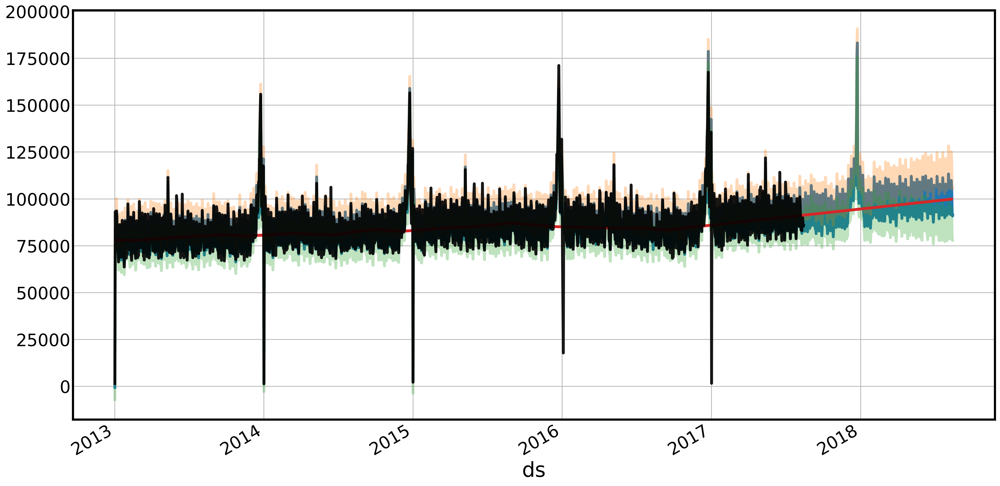

In [79]:
# погрешность уменьшилась в полтора раза!
print('RMSE: %f' % np.sqrt(np.mean((forecast.loc[:1682, 'yhat']-transactions['y'])**2)) )
forecast.set_index("ds",inplace=True)
plt.figure(figsize=(20,10))
forecast.yhat.plot()
forecast.yhat_upper.plot(alpha=0.3)
forecast.yhat_lower.plot(alpha=0.3)
forecast.trend.plot()
plt.plot(transactions.ds.values,transactions.y.values,c='black',alpha=0.9)

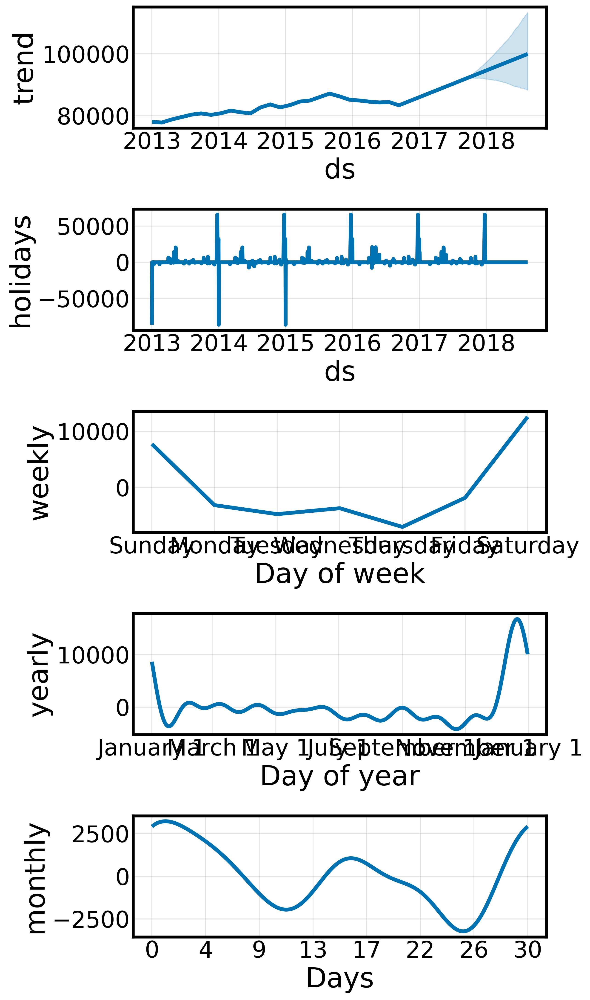

In [80]:
m.plot_components(forecast.reset_index());

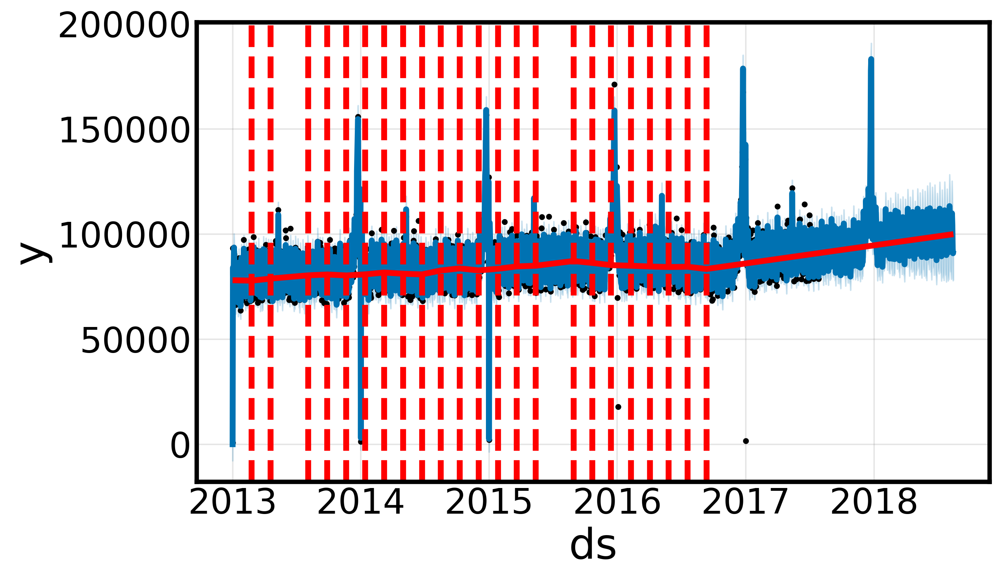

In [81]:
# сильно увеличилось кол-во точек изменения тренда, он стал более адаптивным
from prophet.plot import add_changepoints_to_plot
fig = m.plot(forecast.reset_index())
a = add_changepoints_to_plot(fig.gca(), m, forecast.reset_index())

Как измерить "силу" тренда или сезонности?

Пусть у нас ряд имеет адитивные тренд и сезонность:
$y_t = T_t + S_{t} + R_t,$

Тогда для тренда:

$F_T = \max\left(0, 1 - \frac{\text{Var}(R_t)}{\text{Var}(T_t+R_t)}\right)$

а для сезонности:

$F_S = \max\left(0, 1 - \frac{\text{Var}(R_t)}{\text{Var}(S_{t}+R_t)}\right)$

In [82]:
Rt = forecast.iloc[:-365,:].yhat.subtract(transactions.set_index("ds").y.values,axis=0)
Tt = forecast.iloc[:-365,:].trend
Swt = forecast.iloc[:-365,:].weekly
Syt = forecast.iloc[:-365,:].yearly
Smt = forecast.iloc[:-365,:].monthly

In [83]:
# в целом, все сезонности и тренд отличны от нуля
print(max(0,1-Rt.var()/(Tt+Rt).var()))
print(max(0,1-Rt.var()/(Swt+Rt).var()))
print(max(0,1-Rt.var()/(Syt+Rt).var()))
print(max(0,1-Rt.var()/(Smt+Rt).var()))

0.2810945732960498
0.650784135483607
0.36214150165365955
0.11735485747864027


давайте проверим, улучшилось ли качество на тестовой выборке

In [84]:
forecaster = prophet_sktime(add_seasonality = {'name':'monthly', 
                                              'period':30.5, 
                                              'fourier_order':5},
                           changepoint_prior_scale=2.5, 
                            holidays=holidays,
                            seasonality_prior_scale=20.0
                           )

In [85]:
df2 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True)

21:26:31 - cmdstanpy - INFO - Chain [1] start processing
21:26:32 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:34 - cmdstanpy - INFO - Chain [1] done processing
21:26:35 - cmdstanpy - INFO - Chain [1] start processing
21:26:37 - cmdstanpy - INFO - Chain [1] done processing


In [86]:
df2.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.033122,1.778035,0.332070,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,2017-06-01 81619.529062 2017-06-02 875...
1,0.021594,1.590398,0.331438,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,2017-07-01 101222.459685 2017-07-02 969...
2,0.036198,1.972133,0.330852,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,2017-08-01 85306.851324 2017-08-02 872...


In [87]:
df2y_test = pd.concat([x for x in df2.y_test.values])
df2y_pred = pd.concat([x for x in df2.y_pred.values])

смогли уменьшить погрешность почти в 2 раза!

In [88]:
metrics_report(df1y_test,df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4027.586701,2925.318976,5993.009163,10742.878854,3652.844569
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.354149,3.293633,6.634540,11.432292,3.685203
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.550375,0.550375,0.550375,0.550375,0.550375


In [89]:
metrics_report(df2y_test,df2y_pred)

,mean,median,quan_75,quan_95,std
maes,2691.785306,1645.373365,3767.520838,8179.650172,2769.015267
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,2.902705,1.867256,4.070302,9.222807,2.791011
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.773387,0.773387,0.773387,0.773387,0.773387


<Axes: xlabel='ds'>

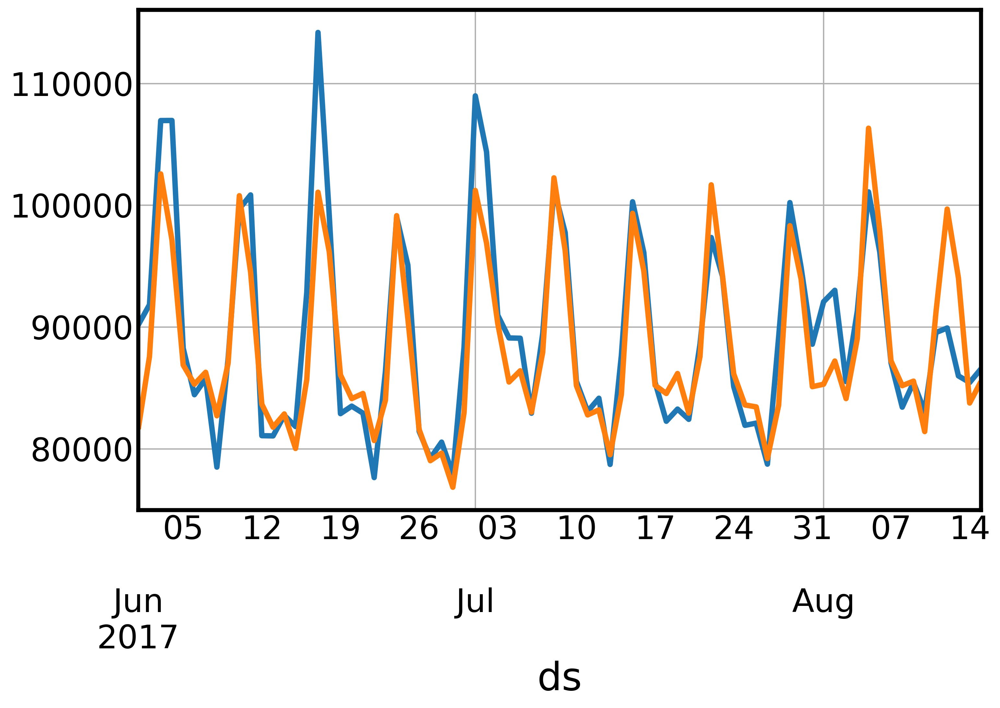

In [90]:
df2y_test.plot()
df2y_pred.plot()

Профет - очень мощный фрэймворк для прогнозирования вр - различные нецелые сезонности, мультипликативные компоненты, кусочно-линейный тренд, который дает неплохие прогнозы прямо их коробки. Пожалуй, единственная слабость - шумные ряды, где экстраполяция начинает плохо работать

## TBATS

TBATS = Trigonometric, Box-Cox transformation, ARMA, Trend, Seasonality.

Тоже универсальный фрэймворк, который может давать предсказания из коробки, но, который, к сожалению, довольно долго обучается.

In [91]:
from sktime.forecasting.tbats import TBATS

forecaster = TBATS(  

    use_box_cox=False,

    use_trend=False,

    use_damped_trend=False,

    sp=[7.,365.25],
    use_arma_errors=False,)

In [91]:
df3 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True,
               error_score='raise')

In [92]:
df3.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.041273,105.341031,0.012513,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,ds 2017-06-01 79046.823171 2017-06-02 ...
1,0.034880,57.416303,0.011373,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,ds 2017-07-01 100386.708435 2017-07-02 ...
2,0.062928,151.845298,0.010874,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,ds 2017-08-01 80988.134652 2017-08-02 83...


In [93]:
df3y_test = pd.concat([x for x in df3.y_test.values],ignore_index=True)
df3y_pred = pd.concat([x for x in df3.y_pred.values],ignore_index=True)

по метрикам из коробки получается не хуже, чем профет

In [94]:
metrics_report(df3y_test.values,df3y_pred.values)

,mean,median,quan_75,quan_95,std
maes,3945.528159,3028.979266,5561.404268,10461.158469,3250.548455
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.293937,3.477167,6.399675,10.904302,3.276384
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.602314,0.602314,0.602314,0.602314,0.602314


In [95]:
metrics_report(df1y_test,df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4027.586701,2925.318976,5993.009163,10742.878854,3652.844569
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.354149,3.293633,6.634540,11.432292,3.685203
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.550375,0.550375,0.550375,0.550375,0.550375


TBATS может быть удобен для первоначальной диагностики ряда

In [96]:
forecaster = TBATS(  

    use_box_cox=None,

    use_trend=None,

    use_damped_trend=None,

    sp=[7.,365.25, 30.5],

    use_arma_errors=True,)

In [97]:
forecaster.fit(transactions_series)

TBATS(sp=[7.0, 365.25, 30.5])

In [98]:
# можно посмотреть все коэффициенты, которые tbats посчитал важными
fitted_model = forecaster._forecaster
print('\n\nMODEL SUMMARY\n\n')
params = fitted_model.params
components = fitted_model.params.components

print('Smoothing parameter', params.alpha)

print('Seasonal periods',
      components.seasonal_periods)  # TBATS may choose non-seasonal model even if you provide seasons
print('Harmonics amount for each season', components.seasonal_harmonics)
print('1st seasonal smoothing parameters', params.gamma_1())  # one value for each season
print('2nd seasonal smoothing parameters', params.gamma_2())  # one value for each season

print('Trend and damping', components.use_trend, components.use_damped_trend)
print('Trend', params.beta)
print('Damping', params.phi)

print('Use Box-Cox', components.use_box_cox)
print('Box-Cox lambda interval that was considered', components.box_cox_bounds)
print('Box-Cox lambda', params.box_cox_lambda)

print('ARMA residuals modelling', components.use_arma_errors)
print('ARMA(p, q)', components.p, components.q)
print('AR parameters', params.ar_coefs)
print('MA parameters', params.ma_coefs)

print('Seed state', params.x0)

# Short model summary
print('\n\nSUMMARY FUNCTION\n\n')
print(fitted_model.summary())



MODEL SUMMARY


Smoothing parameter 0.13018196953342526
Seasonal periods [  7.    30.5  365.25]
Harmonics amount for each season [3 6 1]
1st seasonal smoothing parameters [ 0.00097759 -0.00105756 -0.00460638]
2nd seasonal smoothing parameters [0.00100409 0.00069856 0.00202714]
Trend and damping False False
Trend None
Damping None
Use Box-Cox False
Box-Cox lambda interval that was considered (0, 1)
Box-Cox lambda None
ARMA residuals modelling False
ARMA(p, q) 0 0
AR parameters []
MA parameters []
Seed state [ 7.08587734e+04 -5.28176087e+03  1.20884895e+03 -3.66927126e+02
 -6.11897911e+03  4.91929838e+03 -1.25890802e+03  5.85966718e+02
  1.89969165e+03 -3.49159876e+02 -1.10983752e+03  2.68118580e+02
 -4.94473578e+01  2.16999258e+02 -2.14847533e+02 -7.16505465e+02
  3.22960909e+02  6.96202943e+02  1.36819504e+02  1.59239827e+03
  1.01578578e+03]


SUMMARY FUNCTION


Use Box-Cox: False
Use trend: False
Use damped trend: False
Seasonal periods: [  7.    30.5  365.25]
Seasonal harmonics [3

# О подборе гиперпараметров

В этом разделе кратко обсудим некоторые общие практики для подбора гиперпараметров для различных моделей

## Пример плохого  подбора гиперпараметров

Для начала - как делать не надо. Плохая идея - подбирать гиперпараметры на той же выборке, на которой потом оцениваем качество. В этом случае происходит так называемая "утечка" данных, то есть мы используем данные, которые в будущем нам будут недоступны.

В качестве примера рассмотрим ряд с активностью солнечных пятен, и попробуем оценить по кросс-валидации на последних 100 точках 2 модели - для одной мы подберем гиперпараметры на всем вр, а для другой - не включая последние 100 точек

In [92]:
Sun = pd.read_csv('data/sun.csv')
Sun['YEAR'] = pd.to_datetime(Sun['YEAR'].astype(int).astype(str) + '-01-01')
Sun.set_index("YEAR",inplace=True)
Sun.index = pd.PeriodIndex(Sun.index,freq='Y')

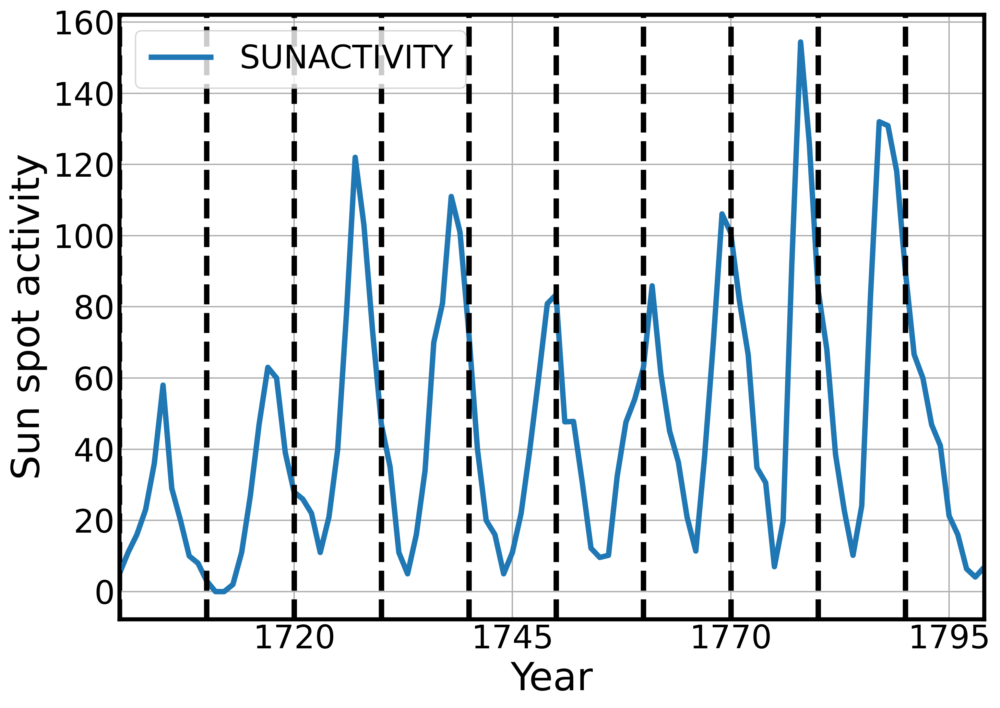

In [93]:
ax = Sun[Sun.index<"1800-01-01"].plot()
ax.set_ylabel('Sun spot activity')
ax.set_xlabel('Year')
for i in range(0,100,10):
    ax.axvline(Sun.index[i],c='black',linestyle='--')

Подберем модель на всем вр

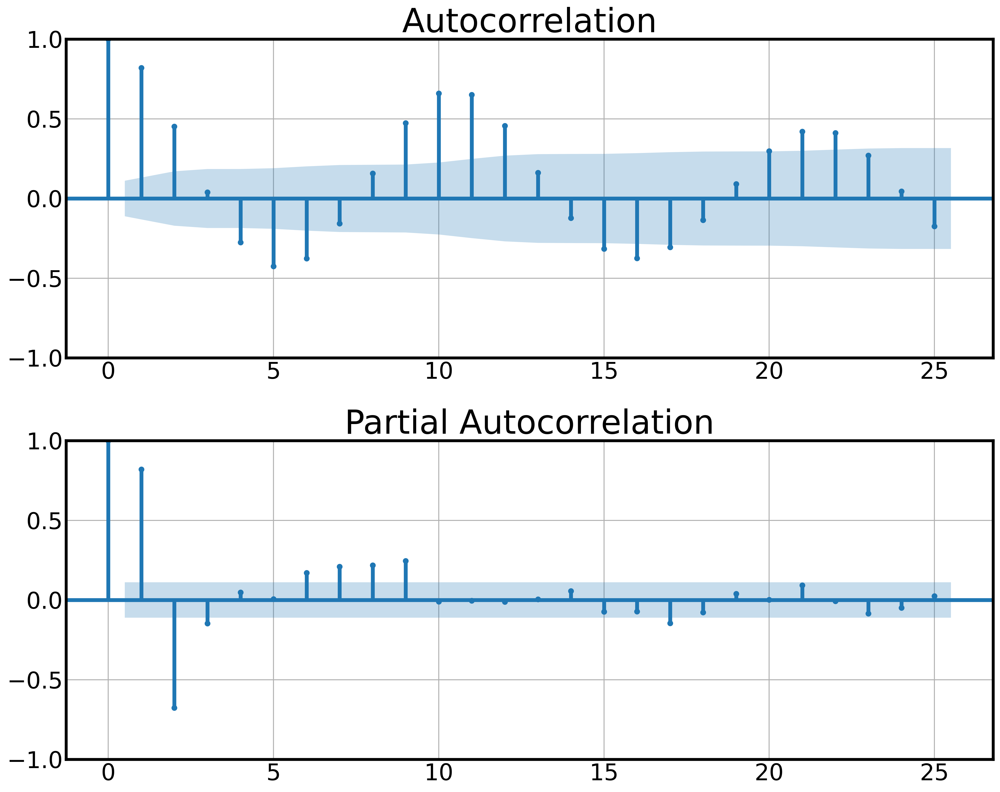

In [94]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(Sun,ax=ax[0]);
tsaplots.plot_pacf(Sun,ax=ax[1]);

In [95]:
forecaster_all = calc_optimum_arma(Sun,3,6)[1]

28


In [96]:
forecaster_all.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  309
Model:               SARIMAX(3, 0, 3)   Log Likelihood               -1281.463
Date:                Mon, 06 May 2024   AIC                           2578.926
Time:                        21:33:21   BIC                           2608.793
Sample:                    12-31-1700   HQIC                          2590.867
                         - 12-31-2008                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.7914      0.707      2.535      0.011       0.407       3.176
ar.L1          2.5407      0.042     60.371      0.000       2.458       2.623
ar.L2         -2.4456      0.069    -35.303      0.000      -2.581      -2.310
ar.L3          0.8692      0.039     22.285      0.000       0.793       0.946
ma.L1         -1.4081      0.064    -21.833      0.000      -1.535      -1.282
ma.L2          0.4381      0.096      4.568      0.000       0.250       0.626
ma.L3          0.1762      0.059      3.009      0.003       0.061       0.291
sigma2       233.6420     16.641     14.041      0.000     201.027     266.257
===================================================================================
Ljung-Box (L1) (Q):                   0.08   Jarque-Bera (JB):                70.06
Prob(Q):                              0.77   Prob(JB):                         0.00
Heteroskedasticity (H):               1.30   Skew:                             0.74
Prob(H) (two-sided):                  0.19   Kurtosis:                         4.80
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Теперь подберем параметры модели на части вр без валидационной выборки.

In [97]:
initial_window=200

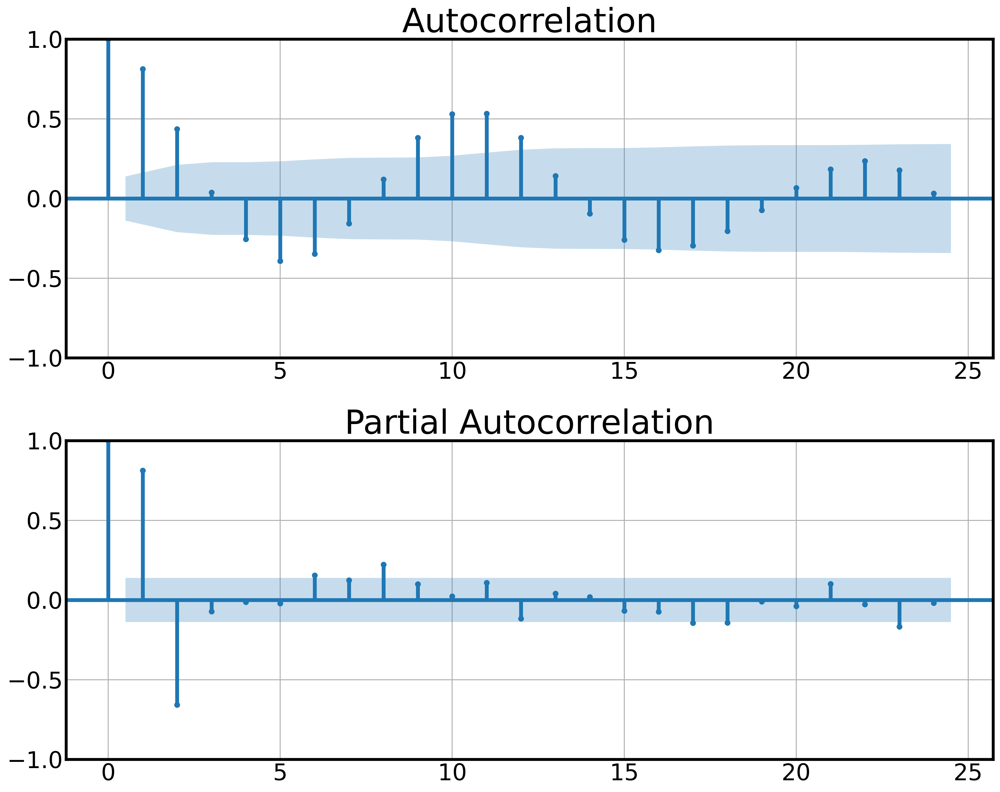

In [98]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(Sun.iloc[:initial_window],ax=ax[0]);
tsaplots.plot_pacf(Sun.iloc[:initial_window],ax=ax[1]);

In [99]:
tbl, forecaster = calc_optimum_arma(Sun.iloc[:initial_window],2,6)

21


In [100]:
forecaster.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  200
Model:               SARIMAX(2, 0, 0)   Log Likelihood                -822.915
Date:                Mon, 06 May 2024   AIC                           1653.830
Time:                        21:34:07   BIC                           1667.023
Sample:                    12-31-1700   HQIC                          1659.169
                         - 12-31-1899                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     13.4585      2.118      6.354      0.000       9.307      17.610
ar.L1          1.3679      0.040     33.899      0.000       1.289       1.447
ar.L2         -0.6746      0.045    -15.056      0.000      -0.762      -0.587
sigma2       216.9629     18.856     11.507      0.000     180.006     253.919
===================================================================================
Ljung-Box (L1) (Q):                   0.09   Jarque-Bera (JB):                34.75
Prob(Q):                              0.77   Prob(JB):                         0.00
Heteroskedasticity (H):               1.40   Skew:                             0.66
Prob(H) (two-sided):                  0.17   Kurtosis:                         4.55
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

теперь их качество на кросс-валидации на последних 100 точках с шагом 1

In [101]:
splitter1 = ExpandingWindowSplitter(fh=1,initial_window=initial_window,step_length=1)

In [102]:
forecaster_all = ARIMA((3,0,3)) # подобрали по всей выборке
forecaster = ARIMA((2,0,0)) # подобрали по части выборки, выкинув валидацию

In [103]:
df1progn = evaluate(forecaster=forecaster, 
              y=Sun.values, 
              cv=splitter1, 
              strategy="refit", 
              return_data=True)

df1progn_all = evaluate(forecaster=forecaster_all, 
              y=Sun.values, 
              cv=splitter1, 
              strategy="refit", 
              return_data=True)

In [104]:
df1progn['y_pred'] = df1progn['y_pred'].apply(lambda x: x.values[0][0]) 
df1progn['y_test'] = df1progn['y_test'].apply(lambda x: x.values[0][0]) 

df1progn_all['y_pred'] = df1progn_all['y_pred'].apply(lambda x: x.values[0][0]) 
df1progn_all['y_test'] = df1progn_all['y_test'].apply(lambda x: x.values[0][0]) 

df1progn['resid'] = df1progn['y_test'] - df1progn['y_pred']
df1progn_all['resid'] = df1progn_all['y_test'] - df1progn_all['y_pred']

оценка качества модели

In [105]:
metrics_report(df1progn['y_test'].values, df1progn['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,14.958759,12.071177,20.510731,39.461372,12.883615
maes_zero,39.433263,38.878899,51.478899,93.321101,26.541564
mapes,54.846993,28.015143,52.990589,158.038061,110.417510
mapes_zero,247.139867,58.102366,235.636308,1042.553098,536.661867
r2,0.827681,0.827681,0.827681,0.827681,0.827681


In [106]:
metrics_report(df1progn_all['y_test'].values, df1progn_all['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,13.250127,10.184717,18.147260,34.676621,11.708911
maes_zero,39.433263,38.878899,51.478899,93.321101,26.541564
mapes,54.644323,23.791374,42.070736,184.064463,121.671775
mapes_zero,247.139867,58.102366,235.636308,1042.553098,536.661867
r2,0.861780,0.861780,0.861780,0.861780,0.861780


<Axes: >

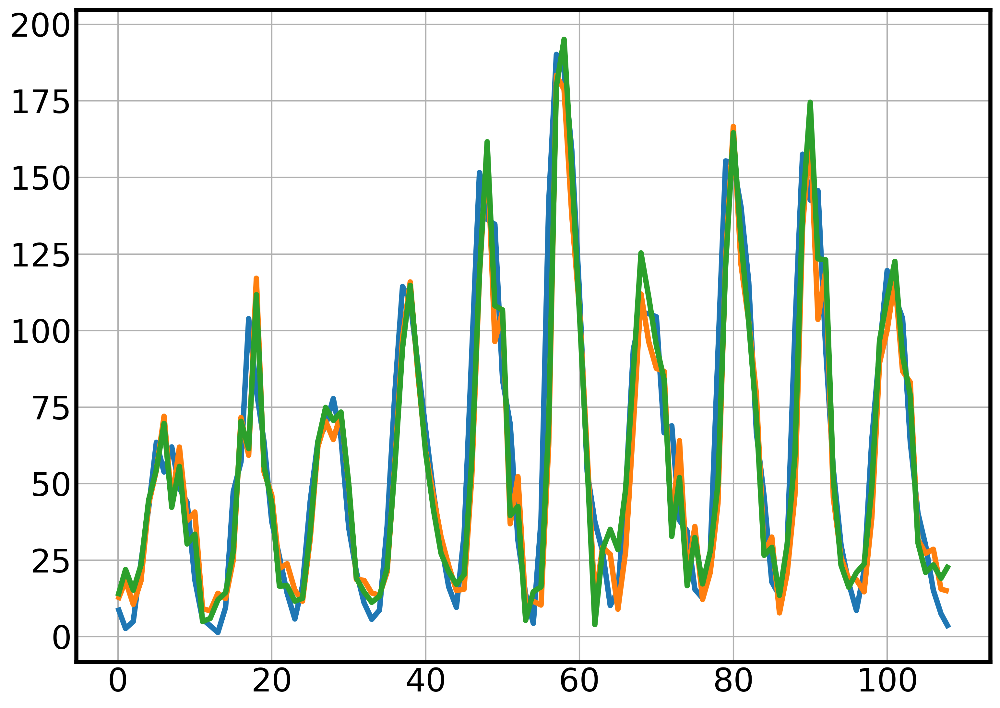

In [107]:
df1progn['y_test'].plot()
df1progn['y_pred'].plot()
df1progn_all['y_pred'].plot()

Видно, что с параметрами, подобранными по всей выборке, качество модели лучше - т.е. они завышены по сравнению с реальной картиной. При подборе гиперпараметров нужно всегда держать в уме возможные "утечки данных", чтобы более точно оценивать качество прогнозов

## Примеры более правильного подбора гиперпараметров

В этом разделе посмотрим 2 стратегии подбора гиперпараметров - по статистическим критериям (согласно оценкам максимального правдоподобия на обучающей выборке) и по временной кросс-валидации

Для простоты будем подбирать параметры для ЭСС модели на вр международных авиаперелетов. Будем подбирать следующие параметры: сезонность - аддитивная/мультипликативная, тренд - аддитивный/мультипликативный, наличие затухания тренда - да/нет, период сезонности. Также теперь мы заранее создадим отложенную выборку с 24 наблюдениями и будем подбирать параметры, не смотря в валидационную часть

In [108]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)
airline.index = pd.PeriodIndex(airline.index,freq='M')

In [109]:
# отложим последние 24 наблюдения в тест чтобы сделать разовый прогноз на все 24 наблюдения
airline_test = airline.iloc[-24:]
airline = airline.iloc[:-24]

Начнем с временной кросс-валидации. Зададим её в том же виде, как на валидации - по последним 24 месяцам в обучающей выборке будем прогнозировать на 24 месяца вперед с шагом 1

In [110]:
# отсупаем на 4 года от конца обучения, чтобы в итоге получить 24 предсказания с горизонтом прогнозирования 24
cv = ExpandingWindowSplitter(fh=list(range(1,25)), initial_window=len(airline['Passengers'])-48, step_length=1)

(<Figure size 4800x1440 with 1 Axes>,
 <Axes: xlabel='Time', ylabel='Window number'>)

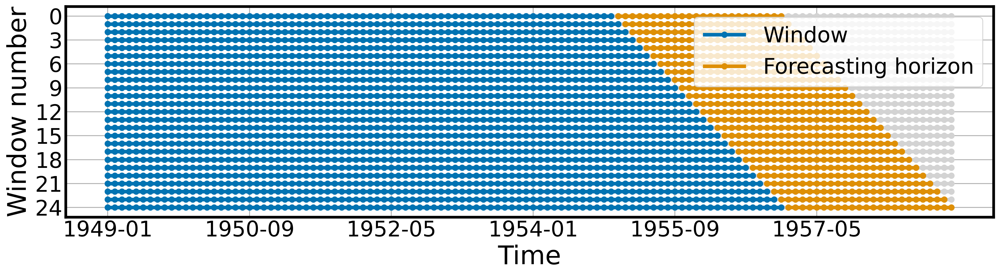

In [111]:
# построим график нашей валидационной схемы - прогноз на 24 месяца скользящим окном в 1 месяц на последние 2 года
from sktime.utils.plotting import plot_windows
plot_windows(cv,airline)

In [112]:
# подбираем параметры на кросс-валидационной схеме с помощью ForecastingGridSearchCV
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.performance_metrics.forecasting import MeanSquaredError

forecaster = ExponentialSmoothing()
param_grid = {
    "sp": [4, 6, 12],
    "seasonal": ["add", "mul"],
    "trend": ["add", "mul"],
    "damped_trend": [True, False],
}
gscv = ForecastingGridSearchCV(
    forecaster=forecaster, #модель
    param_grid=param_grid, # параметры для подбора
    cv=cv, # валидационная схема
    verbose=1,
)# по умолчанию подбирает по mape, за это отвечает параметр scoring
gscv.fit(airline)

Fitting 25 folds for each of 24 candidates, totalling 600 fits


ForecastingGridSearchCV(cv=ExpandingWindowSplitter(fh=[1, 2, 3, 4, 5, 6, 7, 8,
                                                       9, 10, 11, 12, 13, 14,
                                                       15, 16, 17, 18, 19, 20,
                                                       21, 22, 23, 24],
                                                   initial_window=72),
                        forecaster=ExponentialSmoothing(),
                        param_grid={'damped_trend': [True, False],
                                    'seasonal': ['add', 'mul'],
                                    'sp': [4, 6, 12], 'trend': ['add', 'mul']},
                        verbose=1)

In [113]:
# оптимальные параметры
gscv.best_params_

{'damped_trend': True, 'seasonal': 'mul', 'sp': 12, 'trend': 'mul'}

In [114]:
# датафрэйм с результатами валидации
gscv.cv_results_.head()

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.162587,0.130899,0.007277,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",15.0
1,0.185609,0.323121,0.007556,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",23.0
2,0.154691,0.144743,0.007547,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",12.0
3,0.174371,0.333362,0.007493,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",19.0
4,0.081725,0.159656,0.007568,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",7.0


In [115]:
# переведем колонку с dict в отдельные колонки
gscv.cv_results_ = gscv.cv_results_.join(pd.DataFrame(gscv.cv_results_.pop('params').values.tolist()))

In [116]:
# топ-моделей по мапе
gscv.cv_results_.sort_values(by='rank_test_MeanAbsolutePercentageError').head()

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,rank_test_MeanAbsolutePercentageError,damped_trend,seasonal,sp,trend
11,0.047782,0.451618,0.007687,1.0,True,mul,12,mul
23,0.048002,0.208557,0.007511,2.0,False,mul,12,mul
22,0.054309,0.182772,0.007460,3.0,False,mul,12,add
10,0.069195,0.203106,0.007537,4.0,True,mul,12,add
16,0.073298,0.160949,0.007439,5.0,False,add,12,add


Теперь попробуем другой метод валидации - по статистическим критериям, основанным на оценке максимального правдоподобия на обучающей выборке. Для этого обучим все вариации модели ExponentialSmoothing из statsmodels и выберем модель, которая обеспечивает наименьший скорректированный критерий Акаике, который рассчитывается в том же модуле.

In [117]:
# скрипт отрабатывает примерно в 3-4 раза быстрее временной кросс-валидации
from statsmodels.tsa.api import ExponentialSmoothing
min_aicc = 1e100
top_es = None
for trend, is_damped, seasonal, sp in product(["add", "mul"],[True,False],["add", "mul"],[12,6,4]):
    es1 = ExponentialSmoothing(airline,
                               trend = trend,
                               seasonal = seasonal,
                               seasonal_periods = sp,
                               damped_trend = is_damped,
                               initialization_method='heuristic')
    es1 = es1.fit() # обучаем модель 
    if es1.aicc < min_aicc: # запоминаем модель с минимальным критерием акаике
        min_aicc = es1.aicc
        top_es = es1

In [118]:
# оптимальная модель - такая же, как для временной кросс-валидации, но без затухающего тренда
top_es.summary()

Dep. Variable:,Passengers,No. Observations:,120
Model:,ExponentialSmoothing,SSE,11189.266
Optimized:,True,AIC,576.226
Trend:,Multiplicative,BIC,620.826
Seasonal:,Multiplicative,AICC,582.998
Seasonal Periods:,12,Date:,"Mon, 06 May 2024"
Box-Cox:,False,Time:,21:43:45
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.3268788,alpha,True
smoothing_trend,0.000000,beta,True


In [119]:
min_aicc

582.9984878989716

теперь оценим качество двух моделей на отложенной выборке

In [120]:
# модель с параметрами на кросс-валидации
es_cv = ExponentialSmoothing(airline,
                               trend = "mul",
                               seasonal = 'mul',
                               seasonal_periods = 12,
                               damped_trend = True,
                               initialization_method='heuristic') 

# модель с параметрами по критерию Акаике на обучающей выборке
es_mp = ExponentialSmoothing(airline,
                               trend = "mul",
                               seasonal = 'mul',
                               seasonal_periods = 12,
                               damped_trend = False,
                               initialization_method='heuristic')

Обучим модели на всей обучающей выборке и оценим качество на валидационной

In [121]:
es_cv = es_cv.fit()
y_pred_cv = es_cv.predict(len(airline),len(airline)+23)

es_mp = es_mp.fit()
y_pred_mp = es_mp.predict(len(airline),len(airline)+23)

In [122]:
metrics_report(airline_test.values,y_pred_cv.values)

,mean,median,quan_75,quan_95,std
maes,25.405261,25.002409,33.737258,44.658425,13.004558
maes_zero,61.020833,51.500000,90.750000,147.225000,43.974048
mapes,5.644792,5.542736,7.679488,9.486317,2.819566
mapes_zero,13.404779,11.529146,17.878621,27.041097,8.790896
r2,0.855201,0.855201,0.855201,0.855201,0.855201


In [136]:
metrics_report(airline_test.values,y_pred_mp.values)

,mean,median,quan_75,quan_95,std
maes,16.629379,15.655363,22.751842,27.567716,8.849154
maes_zero,61.020833,51.500000,90.750000,147.225000,43.974048
mapes,3.787750,3.647389,5.333168,6.438805,1.997987
mapes_zero,13.404779,11.529146,17.878621,27.041097,8.790896
r2,0.936955,0.936955,0.936955,0.936955,0.936955


Видим, что модель, подобранная по стат критерию бьет по всем метрикам, полученным на кросс-валидации. Отчасти такой результат обусловлен тем, что для валидации мы оставили только 24 наблюдения. Однако, на практике, часто бывает так, что при разбиении на train/test/holdout выборки, в обучающей выборке остается мало данных, в следствие чего падает качество подобранных гиперпараметров. Подбор гиперпараметров по стат критериям такой проблемы не имеет. При достаточным кол-ве данных часто оказывается, что оба метода дают примерно одинаковое улучшения метрик модели, при этом подбор по стат критерия всегда в несколько раз быстрее за счет того, что обучается только один раз. Поэтому если в модуле, которым вы пользуетесь для прогноза, есть оценки максимального правдоподобия, то для подбора гиперпараметров в рамках одной модели рекомендуется использовать именно метод стат. критериев.

## Примеры подбора оптимальной модели

Совсем другая ситуация, когда мы обучили несколько моделей и хотим выбрать наилучшую, или, мы хотим понять, нужны ли нам какие-то предварительные трансформации (например, детрендирование или применение преобразования бокса-кокса). В этом случае мы не всегда можем оценить мпп, а даже если и можем, для разных питон-пакетов и разных моделей оно может считать по-разному, поэтому сравнивать их между собой не совсем корректно. Поэтому здесь рекомендуется использовать кросс-валидацию для определения оптимальной модели

In [124]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.forecasting.theta import ThetaForecaster
from sktime.forecasting.trend import STLForecaster
from sktime.forecasting.statsforecast import StatsForecastAutoARIMA, StatsForecastAutoETS, StatsForecastMSTL
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.fbprophet import Prophet as prophet_sktime
from sktime.forecasting.structural import UnobservedComponents

In [125]:
# убираем ненужные принты
import warnings
warnings.simplefilter("ignore")
warnings.simplefilter("ignore", DeprecationWarning)
warnings.simplefilter("ignore", FutureWarning)

import logging

logging.getLogger('prophet').setLevel(logging.ERROR)

давайте подберем оптимальную модель для датасета с кол-вом международных авиаперелетов

In [126]:
# для кросс-валидации по времени с помощью sktime даты должны содержать в индексе, который должен быть pd.PeriodIndex
airline_val = airline['Passengers']
airline_val.index = pd.PeriodIndex(airline_val.index,freq='M')

In [127]:
from sktime.transformations.series.detrend import Deseasonalizer, Detrender, STLTransformer

In [128]:
from sktime.forecasting.compose import MultiplexForecaster # оберка для выбора оптимальной модели из списка
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# проведем валидацию аналогично пункту 2.2
cv = ExpandingWindowSplitter(fh=24, initial_window=len(airline['Passengers'])-48, step_length=1)

forecaster = MultiplexForecaster(
    forecasters=[
        ("ets", ExponentialSmoothing(sp=12,seasonal ='mul',trend ='mul')), # наша оптимальная ets модель
        ("auto_ets", StatsForecastAutoETS(season_length=12)), # авто-эсс из пакета statsforecast
        ("auto_arima", StatsForecastAutoARIMA(sp=12)), # autoarima из пакета statsforecast
        ("stl", STLForecaster(sp=12)), # прогноз, основанный на stl-декомпозии (тренд - экстраполируют, сезонность - предыдущ.)
        ("auto_arima_stl", STLForecaster(sp=12, # здесь дополнительно остатки моделируются автоаримой
                                         forecaster_resid=AutoARIMA(suppress_warnings=True,sp=12))),  
        ("prophet", prophet_sktime()), # дефолтный профет
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["auto_arima_stl","stl","ets","auto_arima","prophet","auto_ets",]},
    cv=cv,
    n_jobs=6
)
gscv.fit(airline['Passengers'])
gscv.best_params_

{'selected_forecaster': 'auto_arima_stl'}

In [129]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.070067,8.308417,0.060598,{'selected_forecaster': 'auto_arima_stl'},1.0
1,0.070458,0.020791,0.052905,{'selected_forecaster': 'stl'},2.0
2,0.078439,0.194538,0.006775,{'selected_forecaster': 'ets'},3.0
3,0.079300,2.186847,0.060433,{'selected_forecaster': 'auto_arima'},4.0
4,0.102140,0.521725,0.061657,{'selected_forecaster': 'prophet'},5.0
5,0.160463,1.284668,0.027637,{'selected_forecaster': 'auto_ets'},6.0


/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/statsmodels/tsa/holtwinters/model.py:83: RuntimeWarning: overflow encountered in ma

Лучший результат показала комбинация arima+stl. Видно, что при грамотном использовании arima может улучшать результат базовой декомпозиции. Ну и в целом - первые 3 места заняли модели, которые в первую очередь декомпозируют ряд на составляющие. Также можно отметить, что на этом датасете профет сильно проигрывает в качестве stl, ets и autoarima - потому что профет лучше работает именно на дневных данных, а не на месячных

Теперь подберем модель для датасета с солнечными пятнами

In [ ]:
from sktime.forecasting.compose import MultiplexForecaster
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# валидация с шагом 1 на последние 50 точек
cv = ExpandingWindowSplitter(fh=1, initial_window=250, step_length=1)

# т.к. период непостоянен, поставим модели без периодической компоненты
# кроме stl
forecaster = MultiplexForecaster(
        forecasters=[
        ("ets", ExponentialSmoothing(sp=1,seasonal =None,trend ='add')), 
        ("auto_ets", StatsForecastAutoETS(season_length=1)),
        ("auto_arima", StatsForecastAutoARIMA(sp=1)),
        ("stl", STLForecaster(sp=10)),
        ("prophet", prophet_sktime()),
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["stl","ets","auto_arima","prophet","auto_ets",]},
    cv=cv,
    n_jobs=6
)
gscv.fit(Sun)
gscv.best_params_

In [131]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,1.263899,0.025660,0.051454,{'selected_forecaster': 'stl'},5.0
1,0.556005,0.040312,0.008219,{'selected_forecaster': 'ets'},2.0
2,0.519086,0.912672,0.005278,{'selected_forecaster': 'auto_arima'},1.0
3,1.218840,0.100207,0.057411,{'selected_forecaster': 'prophet'},4.0
4,0.573699,0.449292,0.015031,{'selected_forecaster': 'auto_ets'},3.0


Здесь Arima справляется лучше всего - только в её модели заложены возможная стохастическая сезонность с переменным периодом. Для прогноза на 1 шаг неплохо справляется и ets, а вот профет и stl,  заточенные под сезонность, справляются сильно хуже.

итоговая модель arima

In [132]:
gscv.best_forecaster_.forecaster_._forecaster.model_

{'coef': {'ar1': 1.614676506303526,
  'ar2': -0.9353737347406413,
  'ma1': -1.4392981370795868,
  'ma2': 0.45409831233872117,
  'ma3': 0.12868260018441569},
 'sigma2': 240.65999552378662,
 'var_coef': array([[ 0.00035137, -0.00012861, -0.00167719,  0.00219083, -0.00041525],
        [-0.00027742,  0.00012638,  0.00135796, -0.00186264,  0.0002926 ],
        [-0.00256147,  0.00105991,  0.01630343, -0.02053642,  0.00285351],
        [ 0.00342001, -0.00147332, -0.02053642,  0.02642046, -0.0037274 ],
        [-0.0005978 ,  0.00021881,  0.00285351, -0.0037274 ,  0.00070649]]),
 'mask': array([ True,  True,  True,  True,  True]),
 'loglik': -1280.0232952051606,
 'aic': 2572.046590410321,
 'arma': (2, 3, 0, 0, 1, 1, 0),
 'residuals': array([ 4.99999399e-03,  3.87028735e+00,  1.36132688e+00,  3.96440575e+00,
         8.89876623e+00,  1.59974149e+01, -3.03198360e+01,  7.98035937e+00,
        -1.07990033e+00,  4.36665489e+00, -5.29170397e+00, -6.16617969e+00,
        -6.84045002e+00, -7.14354119e+

In [133]:
from statsforecast.arima import arima_string, print_statsforecast_ARIMA

In [135]:
print_statsforecast_ARIMA(gscv.best_forecaster_.forecaster_._forecaster.model_)

ARIMA(2,1,3)                   

Coefficients:
               ar1    ar2    ma1    ma2    ma3
coefficient  1.615 -0.935 -1.439  0.454  0.129
s.e.         0.019  0.011  0.128  0.163  0.027

sigma^2 = 240.66: log likelihood = -1280.02

AIC=2572.05


Наконец, посмотрим как данные модели справляются с длинными подневными данными.

In [142]:
transactions_series_val = transactions_series
transactions_series_val.index = pd.PeriodIndex(transactions_series_val.index,freq='D')

In [ ]:
from sktime.forecasting.compose import MultiplexForecaster
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# в качестве валидации берем последний месяц
cv = ExpandingWindowSplitter(fh=31, initial_window=len(transactions_series)-62, step_length=1)

# для моделей с одной сезонностью будем брать с меньшей частотой, чтобы более долгая частота попала в тренд
forecaster = MultiplexForecaster(
        forecasters=[
        ("ets", ExponentialSmoothing(sp=7,seasonal ='add',trend ='add')),# ets c одной сезонностью
        ("auto_arima", StatsForecastAutoARIMA(sp=7)),
        ("stl", STLForecaster(sp=7)),
        ("mstl", StatsForecastMSTL(season_length=[7,365])),# STL с двумя сезонностями
        ("auto_arima_stl", STLForecaster(sp=7,
                                         forecaster_resid=AutoARIMA(suppress_warnings=True,sp=7))),#stl + autoarima
        ("prophet", prophet_sktime()),
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["auto_arima_stl","stl","ets","auto_arima","prophet","mstl",]},
    cv=cv
)
gscv.fit(transactions_series_val)
gscv.best_params_

In [144]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.060481,85.929746,0.061429,{'selected_forecaster': 'auto_arima_stl'},5.0
1,0.059961,0.046935,0.047142,{'selected_forecaster': 'stl'},4.0
2,0.037300,0.353593,0.026177,{'selected_forecaster': 'ets'},2.0
3,0.109121,5.691016,0.048678,{'selected_forecaster': 'auto_arima'},6.0
4,0.033304,0.387573,0.064847,{'selected_forecaster': 'prophet'},1.0
5,0.041680,3.474769,0.017675,{'selected_forecaster': 'mstl'},3.0


На длинных данных с двумя сезонностями prophet первенствует, а auto-arima, наоборот, находится в конце рейтинга